# Real-Estate Investment Analysis of Toronto Neighbourhoods

### Applied Data Science Capstone Project  - IBM 

## A. Introduction 

**Real Estate Investment** involves purchasing, managing, renting and selling real or physical property, for a profit.
Such an investment is characterised by a large amount of capital, and involves careful planning and decision making, for it to be a successful one.  

A **Neighbourhood-wise Analysis** of **Residential Real Estate** in the **140 Neighbourhoods of Toronto**, to determine which Neighbourhood would potentially offer a good return on investment, is the *goal of this project*.

**Toronto** is the largest and most populous city in Canada, known for being *diverse, multicultural and home to world class-amenities*, making it a great place to invest in a house!

When investing in a property, an overall market analysis will provide a good idea of the trends , but will not suffice. It is imperative to buy property in the **right neighbourhood**, because even if the overall market is great, a wrong location may lead to decreased property value in the future.

A Neighbourhood Analysis will reveal the **investment potential** of various neighbourhoods, based on their characteristics.

### Target Audience

This Analysis is targetted towards Companies & Individuals who are interested in investing residential property in Toronto. Whether it be a **real estate firm** looking for the apt location to start a new project, or **individuals** who wish to invest in a home in Toronto for living or simply renting out their property, this analysis will provide a comprehensive understanding of the most suitable neighbourhood according to ones needs.

Moreover, a Neighbourhood analysis not only reveals the investment potential for Residential Real Estate, but can also be applied for any other type of real estate!




## B. Data

#### Data pertaining to the following factors is used in the Neighbourhood Analysis:

### **Location** : 

This is the most **important** factor in Real Estate Investment. A **good location** has **close proximity** to transport, schools, recreation, shopping, employment and various other Amenities. 

**Amenities** are enhancing features, which benefit a location, contribute to its enjoyment and *increase its value*.  Amenities include parks,hospitals,restaurants,gyms etc.

The Location data will be collected using the **search** and **explore endpoint** of the  **Foursquare API**.
                 



### **Demographics** : 

The **Population, Age, Educational Attainment, Crime Rate and Median Income Levels** of a Neighbourhood, have a great impact on the *value and investment potential* of the Houses in it.

Therefore, it's essential to analyze the Demographics of neighbourhoods, and rank them accordingly.

The Demographic data is taken from the **'Neighbourhood Profiles'** Dataset of the [City of Toronto’s Open                             Data Portal](https://open.toronto.ca/dataset/neighbourhood-profiles/).

  
  



### **Real Estate Market** : 

Real Estate Data such as: 

* House Values
* Structure Type 
* Number of Bedrooms
* Year of Construction
* Rental Rates
* Total Sales and Sales Volume
* Sales Price to List Price Ratio
* Average Days on Market

   are factors that influence the value of a property.  
     
The real estate data is collected from the **Community Reports** and **Market Watch** of                                       [TRREB(Toronto Real Estate Board)](https://trreb.ca/index.php/market-news/community-reports) &                         [Realosophy](https://www.realosophy.com/toronto/neighbourhood-map).


                      
### **Neighbourhood Maps**


For visualizing the data geospatially, the **Folium** library is used. The **Coordinates** of each neighbourhood in Toronto is taken from [Geodatos](https://www.geodatos.net/en/coordinates), as it provided very accurate coordinates when compared to the Geopy Library. The GeoJson for mapping the boundaries of neighbourhoods is taken from City of Toronto’s Open Data Portal.                                                



## Lets have a look at the Data

### Importing Libraries

In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)
import json
import requests
from pandas.io.json import json_normalize
from geopy.geocoders import Nominatim 
import folium
from folium import GeoJson

## B.1. Demographic and Real Estate Data

#### The *Demographic* and *Real Estate* Data have been cleaned by me and saved to a new csv file, which is provided my Git repository.

In [2]:
data=pd.read_csv('TorontoREdata.csv')
data.drop('Unnamed: 0', axis=1, inplace=True)
data.head()

,Neighbourhood,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($)
0,Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750
1,Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900
2,Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425
3,Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200
4,Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750


### A brief description of the dataset is given below:

The columns from **'Population,2016'** to **'Crime Rate'** are the **Demographic Features**, which include:

* **Population,2016**: Total population of each neighbourhood as per the 2016 Census
* **Population Growth**: Percentage growth of population in each neighbourhood
* **Age groups( Children - Seniors )** residing in each neighbourhood
* **Educational Attainment ( High School - Doctorate )** of the neighbourhood population
* **Median Household Income**: This is the Median income **before Tax**
* **Employment and Unemployment Rates**
* **Total Crime & Crime Rate**: Crime Rate is expressed as crime **per 1,000** people (Total Crime/Population * 1000)

#### A Neighbourhood with good Population growth, high Educational attainment, greater Median income, high employment rate, low unemployment rate, low crime rate, is generally considered to be an IDEAL Neighbourhood.

The columns from **'Detached House'** to **'Median Rent($)'** are the **Real Estate Data**, which include:

* **Structure** ( Detached House - Row house) : It shows the number of houses which are detached, semi-detached, Apartments/Condos, other attached dwellings and row houses , per neighbourhood
* **Owned vs Rented** : Number of houses which are owner occupied and renter occupied, per neighbourhood
* **Number of Bedrooms** : Number of houses with 1, 2, 3, 4 or more bedrooms
* **Year of Construction**: Number of houses in different years of construction, starting from pre-1960s' to 2016
* **Home Sales**: Number of homes sold per neighbourhood 
* **Sales Volume**: Total Sales Volume in dollars, per neighbourhood
* **Average Price**: Average home price per neighbourhood
* **Median Price**: Median home price per neighbourhood
* **New Listings**: Number of new sale listings in the market for each neighbourhood
* **Active Listings**: Number of listings active in the market for each neighbourhood
* **Average SP/LP**: This is the **Average Sales price to List Price Ratio**. It is a very important indicator in real estate investment analysis. It is the **Final Sale Price/Last List Price * 100** . 
* **Average Days on Market**: It measures the number of days a listing has been on the market, until sold.
* **Median Rent($)**: The median rent for a house per neighbourhood


#### A Neighbourhood with greater home sales and sale volume, high average SP/LP, low Average days on market, indicates that the properties in the neighbourhood are High in demand and selling quickly, and are favourable among investors.


## Neighbourhood Coordinates

#### The coordinates of the neighbourhoods are in a csv file, also available in my Git repository

In [3]:
coordinates= pd.read_csv('newcoor.csv')
coordinates.drop('Unnamed: 0',axis=1,inplace=True)
coordinates.dtypes

Latitude         float64
Longitude         object
Neighbourhood     object
dtype: object

In [4]:
coordinates['Longitude']=coordinates['Longitude'].astype(str).astype(float)
coordinates['Neighbourhoods']=data['Neighbourhood']
coordinates.drop('Neighbourhood',axis=1,inplace=True)
coordinates.head()

,Latitude,Longitude,Neighbourhoods
0,43.808038,-79.266439,Agincourt North
1,43.788660,-79.265610,Agincourt South-Malvern West
2,43.601717,-79.545233,Alderwood
3,43.670338,-79.407117,Annex
4,43.737660,-79.349720,Banbury-Don Mills


## Let's get the coordinates of Toronto and visualize the 140 neighbourhoods, along with their boundaries with the Folium Library

In [5]:
address = 'Toronto, CA'

geolocator = Nominatim(user_agent="tor_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinates of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinates of Toronto are 43.6534817, -79.3839347.


In [6]:
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=11) 

geo=r'Neighbourhoods.json' 
file = open(geo, encoding="utf8")
text = file.read()

GeoJson(text).add_to(map_toronto) #adding boundaries to the map using a GeoJson file

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_toronto)  
    
map_toronto

## B.2. Location Data with Foursquare API 

Location is the **most important factor** when it comes to Real estate analysis. By location, we mean the proximity of the property to various **Amenities**.

A property which has **accessibilty** to **Public Transport, Roads, Hospitals, Schools, Convenience Stores....**and the like, is much more valuable than a property that doesn't.

So, in addition to Demographic and Real estate data, Location data is also crucial.

Amenities can be of many categories, so it's not practical to search for all of them individually.

Therefore, I will use the **Foursquare API** in the following way:

* **Search Endpoint** to collect data on the most important amenities, which are **Schools, Groceries/Covenience Stores and Hospitals**
* **Explore Endpoint** to collect data on amenities like **Recreation, Shopping, Restaurants, Transport, Banks....**  in each Neighbourhood, and then sort & group them into relevant categories.



## B.2.1. Search Endpoint

##  Schools 

 Firstly, lets define a function that loops through the neighbourhoods coordinates , makes requests to the Foursquare API, adds the results to a list , and finally transforms the data to a Pandas Dataframe

In [8]:
def Nearbyschools(names, latitudes, longitudes, radius=500):
    search_query='school'
    schools_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&oauth_token={}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, lat, lng,ACCESS_TOKEN, VERSION, search_query, radius, LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['venues']
        
        # return only relevant information for each nearby school
        try:
            schools_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng'],  
            v['categories'][0]['name']) for v in results])
        except:
            schools_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng']) for v in results])

    nearby_schools = pd.DataFrame([item for schools_list in schools_list for item in schools_list])
    nearby_schools.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_schools)

In [9]:
schools=Nearbyschools(names=coordinates['Neighbourhoods'],
                     latitudes=coordinates['Latitude'],
                     longitudes=coordinates['Longitude'])

Let's group the schools by neighbourhood, and see how many schools are there per neighbourhood.

In [10]:
schools.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Agincourt North,3,3,3,3,3,3
Alderwood,2,2,2,2,2,2
Annex,7,7,7,7,7,7
Banbury-Don Mills,2,2,2,2,2,2
Bathurst Manor,2,2,2,2,2,2
Bay Street Corridor,34,34,34,34,34,34
Bayview Village,2,2,2,2,2,0
Bayview Woods-Steeles,1,1,1,1,1,1
Bedford Park-Nortown,2,2,2,2,2,2


In [11]:
schools.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.808038,-79.266439,Scarborough Percy Williams YMCA Before and Aft...,43.812720,-79.265788,Daycare
1,Agincourt North,43.808038,-79.266439,Albert cambell high school,43.810269,-79.272044,High School
2,Agincourt North,43.808038,-79.266439,Percy William Public School,43.813077,-79.265401,School
3,Alderwood,43.601717,-79.545233,Sir Adam Beck Public School,43.601240,-79.548780,School
4,Alderwood,43.601717,-79.545233,Alderwood Action After School Inc,43.600980,-79.548485,Daycare


Checking for missing values and then one-hot encoding the categories

In [12]:
schools['Venue Category'].isnull().value_counts()

False    413
True      79
Name: Venue Category, dtype: int64

In [13]:
schools['Venue Category'].fillna('School',inplace=True)

In [14]:
schools_onehot = pd.get_dummies(schools[['Venue Category']], prefix="", prefix_sep="")
schools_onehot.head()

,Adult Education Center,American Restaurant,Art Gallery,Art Studio,Astrologer,Athletics & Sports,Building,Church,Coffee Shop,College & University,College Academic Building,College Administrative Building,College Arts Building,College Classroom,College Communications Building,College Gym,College History Building,College Soccer Field,College Technology Building,Community College,Cooking School,Dance Studio,Daycare,Driving School,Elementary School,Event Space,Field,General College & University,General Entertainment,Government Building,Gym,Gym Pool,High School,Housing Development,Indie Theater,Law School,Medical School,Middle School,Music School,Music Venue,Neighborhood,Nursery School,Office,Other Event,Other Great Outdoors,Other Nightlife,Park,Performing Arts Venue,Playground,Private School,Public Art,School,Skate Park,Soccer Field,Spa,Student Center,Swim School,Theater,Trade School,University
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [15]:
schools_onehot.columns.to_list()

['Adult Education Center',
 'American Restaurant',
 'Art Gallery',
 'Art Studio',
 'Astrologer',
 'Athletics & Sports',
 'Building',
 'Church',
 'Coffee Shop',
 'College & University',
 'College Academic Building',
 'College Administrative Building',
 'College Arts Building',
 'College Classroom',
 'College Communications Building',
 'College Gym',
 'College History Building',
 'College Soccer Field',
 'College Technology Building',
 'Community College',
 'Cooking School',
 'Dance Studio',
 'Daycare',
 'Driving School',
 'Elementary School',
 'Event Space',
 'Field',
 'General College & University',
 'General Entertainment',
 'Government Building',
 'Gym',
 'Gym Pool',
 'High School',
 'Housing Development',
 'Indie Theater',
 'Law School',
 'Medical School',
 'Middle School',
 'Music School',
 'Music Venue',
 'Neighborhood',
 'Nursery School',
 'Office',
 'Other Event',
 'Other Great Outdoors',
 'Other Nightlife',
 'Park',
 'Performing Arts Venue',
 'Playground',
 'Private School',
 '

Keeping the required columns 

In [16]:
schools_columns=['Elementary School','High School','Middle School','Nursery School','School','Private School']
schools1=schools_onehot.loc[:,schools_columns]

In [17]:
schools1['Neighbourhood']=schools['Neighborhood']
schools1.set_index('Neighbourhood')
schools1=schools1.groupby('Neighbourhood').sum()
schools1.head()

,Elementary School,High School,Middle School,Nursery School,School,Private School
Neighbourhood,,,,,,
Agincourt North,0,1,0,0,1,0
Alderwood,0,0,0,0,1,0
Annex,0,2,1,0,0,1
Banbury-Don Mills,0,0,0,0,2,0
Bathurst Manor,0,0,0,0,2,0


Creating a new Dataframe **Amenities** and joining the schools to it

In [18]:
Amenities=pd.DataFrame()
Amenities['Neighbourhood']=coordinates['Neighbourhoods']
Amenities.set_index('Neighbourhood')
Amenities.head()

,Neighbourhood
0,Agincourt North
1,Agincourt South-Malvern West
2,Alderwood
3,Annex
4,Banbury-Don Mills


Notice that not all neighbourhoods have schools, so i created a left join for the Amenities dataframe ,to keep rows of other neighbourhoods as well

In [19]:
Amenities1=pd.merge(left=Amenities, right=schools1, how='left', left_on='Neighbourhood', right_on='Neighbourhood')

In [20]:
Amenities1.head()

,Neighbourhood,Elementary School,High School,Middle School,Nursery School,School,Private School
0,Agincourt North,0.0,1.0,0.0,0.0,1.0,0.0
1,Agincourt South-Malvern West,NaN,NaN,NaN,NaN,NaN,NaN
2,Alderwood,0.0,0.0,0.0,0.0,1.0,0.0
3,Annex,0.0,2.0,1.0,0.0,0.0,1.0
4,Banbury-Don Mills,0.0,0.0,0.0,0.0,2.0,0.0


In [21]:
Amenities1.fillna(0,inplace=True)
Amenities1.head()

,Neighbourhood,Elementary School,High School,Middle School,Nursery School,School,Private School
0,Agincourt North,0.0,1.0,0.0,0.0,1.0,0.0
1,Agincourt South-Malvern West,0.0,0.0,0.0,0.0,0.0,0.0
2,Alderwood,0.0,0.0,0.0,0.0,1.0,0.0
3,Annex,0.0,2.0,1.0,0.0,0.0,1.0
4,Banbury-Don Mills,0.0,0.0,0.0,0.0,2.0,0.0


In [22]:
Amenities1['Schools']=Amenities1.sum(axis=1)
columns_needed=['Neighbourhood','Schools']
Amenities1=Amenities1.loc[:,columns_needed]
Amenities1.head()

,Neighbourhood,Schools
0,Agincourt North,2.0
1,Agincourt South-Malvern West,0.0
2,Alderwood,1.0
3,Annex,4.0
4,Banbury-Don Mills,2.0


## Grocery & Convenience Stores

Let's repeat the same process done for schools, to obtain location data for Grocery & Convenience stores

In [23]:
def Nearbygrocery(names, latitudes, longitudes, radius=500):
    search_query='grocery'
    gc_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&oauth_token={}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, lat, lng,ACCESS_TOKEN, VERSION, search_query, radius, LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['venues']
        
        # return only relevant information for each nearby grocery/convenience
        try:
            gc_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng'],  
            v['categories'][0]['name']) for v in results])
        except:
            gc_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng']) for v in results])

    nearby_grocery = pd.DataFrame([item for gc_list in gc_list for item in gc_list])
    nearby_grocery.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_grocery)

In [24]:
groceries= Nearbygrocery(names=coordinates['Neighbourhoods'],
                     latitudes=coordinates['Latitude'],
                     longitudes=coordinates['Longitude'])

In [25]:
groceries.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Annex,2,2,2,2,2,2
Banbury-Don Mills,1,1,1,1,1,1
Broadview North,1,1,1,1,1,1
Cabbagetown-South St. James Town,2,2,2,2,2,2
Corso Italia-Davenport,4,4,4,4,4,4
Dovercourt-Wallace Emerson-Junction,1,1,1,1,1,1
Dufferin Grove,1,1,1,1,1,1
Forest Hill North,1,1,1,1,1,1
Greenwood-Coxwell,1,1,1,1,1,1


In [26]:
groceries['Venue Category'].isnull().value_counts()

False    44
True      1
Name: Venue Category, dtype: int64

In [27]:
groceries['Venue Category'].fillna('Grocery Store',inplace=True)

In [28]:
groceries_onehot = pd.get_dummies(groceries[['Venue Category']], prefix="", prefix_sep="")
groceries_onehot.head()

,Butcher,Coffee Shop,Convenience Store,Deli / Bodega,Diner,Fish Market,Gourmet Shop,Grocery Store,Market,Smoke Shop,Snack Place,Supermarket
0,0,0,0,0,0,0,0,1,0,0,0,0
1,0,0,0,0,0,0,0,1,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,0,0,1,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,1


In [29]:
groceries_onehot.columns.to_list()

['Butcher',
 'Coffee Shop',
 'Convenience Store',
 'Deli / Bodega',
 'Diner',
 'Fish Market',
 'Gourmet Shop',
 'Grocery Store',
 'Market',
 'Smoke Shop',
 'Snack Place',
 'Supermarket']

In [30]:
groceries_onehot['Neighbourhood']=groceries['Neighborhood']
groceries_columns=['Neighbourhood','Butcher', 'Convenience Store','Fish Market','Gourmet Shop', 'Grocery Store','Market','Supermarket']
groceries1=groceries_onehot.loc[:,groceries_columns]
groceries1=groceries1.groupby('Neighbourhood').sum()
groceries1['Grocery/Convenience Store']=groceries1.sum(axis=1)
groceries1=groceries1.loc[:,['Grocery/Convenience Store']]
groceries1.head()

,Grocery/Convenience Store
Neighbourhood,
Annex,2
Banbury-Don Mills,1
Broadview North,1
Cabbagetown-South St. James Town,2
Corso Italia-Davenport,3


In [31]:
Amenities2=pd.merge(left=Amenities1, right=groceries1, how='left', left_on='Neighbourhood', right_on='Neighbourhood')
Amenities2.head()

,Neighbourhood,Schools,Grocery/Convenience Store
0,Agincourt North,2.0,NaN
1,Agincourt South-Malvern West,0.0,NaN
2,Alderwood,1.0,NaN
3,Annex,4.0,2.0
4,Banbury-Don Mills,2.0,1.0


In [32]:
Amenities2.fillna(0,inplace=True)
Amenities2.head()

,Neighbourhood,Schools,Grocery/Convenience Store
0,Agincourt North,2.0,0.0
1,Agincourt South-Malvern West,0.0,0.0
2,Alderwood,1.0,0.0
3,Annex,4.0,2.0
4,Banbury-Don Mills,2.0,1.0


## Hospitals

Let's repeat the same process done for Schools and Grocery & Convenience stores, to obtain location data for Hospitals

In [33]:
def Nearbyhospital(names, latitudes, longitudes, radius=500):
    search_query='hospital'
    hospital_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/search?client_id={}&client_secret={}&ll={},{}&oauth_token={}&v={}&query={}&radius={}&limit={}'.format(CLIENT_ID, CLIENT_SECRET, lat, lng,ACCESS_TOKEN, VERSION, search_query, radius, LIMIT)
            
        # make the GET request
        results = requests.get(url).json()['response']['venues']
        
        # return only relevant information for each nearby hospitals
        try:
            hospital_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng'],  
            v['categories'][0]['name']) for v in results])
        except:
            hospital_list.append([(
            name, 
            lat, 
            lng, 
            v['name'], 
            v['location']['lat'], 
            v['location']['lng']) for v in results])

    nearby_hospitals = pd.DataFrame([item for hospital_list in hospital_list for item in hospital_list])
    nearby_hospitals.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_hospitals)

In [34]:
hospitals=Nearbyhospital(names=coordinates['Neighbourhoods'],
                     latitudes=coordinates['Latitude'],
                     longitudes=coordinates['Longitude'])

In [35]:
hospitals.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Annex,1,1,1,1,1,1
Banbury-Don Mills,1,1,1,1,1,1
Bay Street Corridor,50,50,50,50,50,0
Bedford Park-Nortown,1,1,1,1,1,1
Blake-Jones,2,2,2,2,2,0
Briar Hill-Belgravia,1,1,1,1,1,1
Cabbagetown-South St. James Town,1,1,1,1,1,1
Church-Yonge Corridor,14,14,14,14,14,14
Clairlea-Birchmount,1,1,1,1,1,0


In [36]:
hospitals['Venue Category'].isnull().value_counts()

False    87
True     54
Name: Venue Category, dtype: int64

In [37]:
hospitals['Venue Category'].fillna('Hospital',inplace=True)

In [38]:
hospitals_onehot = pd.get_dummies(hospitals[['Venue Category']], prefix="", prefix_sep="")
hospitals_onehot.head()

,Auto Garage,Café,Church,Coffee Shop,College Academic Building,Deli / Bodega,Doctor's Office,Emergency Room,Eye Doctor,Furniture / Home Store,General Travel,Gift Shop,Hospital,Medical Center,Pet Service,Pharmacy,Street Art,Veterinarian
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
2,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0


In [39]:
hospitals_onehot.columns.to_list()

['Auto Garage',
 'Café',
 'Church',
 'Coffee Shop',
 'College Academic Building',
 'Deli / Bodega',
 "Doctor's Office",
 'Emergency Room',
 'Eye Doctor',
 'Furniture / Home Store',
 'General Travel',
 'Gift Shop',
 'Hospital',
 'Medical Center',
 'Pet Service',
 'Pharmacy',
 'Street Art',
 'Veterinarian']

In [40]:
hospitals_onehot['Neighbourhood']=hospitals['Neighborhood']
hospital_columns=['Neighbourhood',"Doctor's Office", 'Emergency Room','Hospital','Medical Center','Pharmacy']
hospitals1=hospitals_onehot.loc[:,hospital_columns]
hospitals1=hospitals1.groupby('Neighbourhood').sum()
hospitals1['Hospital/Pharmacy']=hospitals1.sum(axis=1)
hospitals1=hospitals1.loc[:,['Hospital/Pharmacy']]
hospitals1.head()

,Hospital/Pharmacy
Neighbourhood,
Annex,0
Banbury-Don Mills,0
Bay Street Corridor,50
Bedford Park-Nortown,1
Blake-Jones,2


In [41]:
Amenities3=pd.merge(left=Amenities2, right=hospitals1, how='left', left_on='Neighbourhood', right_on='Neighbourhood')
Amenities3.head()

,Neighbourhood,Schools,Grocery/Convenience Store,Hospital/Pharmacy
0,Agincourt North,2.0,0.0,NaN
1,Agincourt South-Malvern West,0.0,0.0,NaN
2,Alderwood,1.0,0.0,NaN
3,Annex,4.0,2.0,0.0
4,Banbury-Don Mills,2.0,1.0,0.0


In [42]:
Amenities3.fillna(0,inplace=True)
Amenities3.head()

,Neighbourhood,Schools,Grocery/Convenience Store,Hospital/Pharmacy
0,Agincourt North,2.0,0.0,0.0
1,Agincourt South-Malvern West,0.0,0.0,0.0
2,Alderwood,1.0,0.0,0.0
3,Annex,4.0,2.0,0.0
4,Banbury-Don Mills,2.0,1.0,0.0


## B.2.2 Amenities with the Explore Endpoint

Let's get location data for the rest of the amenities like **recreation, restaurants, gyms....** using the explore endpoint, and then sorting them out into relevant categories.

In [43]:
def NearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        
            
        
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [44]:
toronto_venues= NearbyVenues(names=coordinates['Neighbourhoods'],
                                   latitudes=coordinates['Latitude'],
                                   longitudes=coordinates['Longitude'])

 Let's see the number of venues returned for each neighbourhood

In [45]:
toronto_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Agincourt North,25,25,25,25,25,25
Agincourt South-Malvern West,21,21,21,21,21,21
Alderwood,7,7,7,7,7,7
Annex,38,38,38,38,38,38
Banbury-Don Mills,26,26,26,26,26,26
Bathurst Manor,4,4,4,4,4,4
Bay Street Corridor,66,66,66,66,66,66
Bayview Village,3,3,3,3,3,3
Bayview Woods-Steeles,1,1,1,1,1,1


In [46]:
print('There are {} uniques categories.'.format(len(toronto_venues['Venue Category'].unique())))

There are 284 uniques categories.


Let's have a look at the venues returned, and their respective categories

In [47]:
toronto_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Agincourt North,43.808038,-79.266439,Menchie's,43.808338,-79.268288,Frozen Yogurt Shop
1,Agincourt North,43.808038,-79.266439,Saravanaa Bhavan South Indian Restaurant,43.810117,-79.269275,Indian Restaurant
2,Agincourt North,43.808038,-79.266439,Congee Town 太皇名粥,43.809035,-79.267634,Chinese Restaurant
3,Agincourt North,43.808038,-79.266439,Shoppers Drug Mart,43.808894,-79.269854,Pharmacy
4,Agincourt North,43.808038,-79.266439,Booster Juice,43.809915,-79.269382,Juice Bar


 One-hot Encoding categories, into a new DataFrame

In [48]:
toronto_onehot = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")
toronto_onehot.head()

,ATM,Accessories Store,Adult Boutique,Afghan Restaurant,African Restaurant,American Restaurant,Amphitheater,Animal Shelter,Antique Shop,Arcade,Argentinian Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Dealership,Auto Garage,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Beach,Beer Bar,Beer Store,Belgian Restaurant,Big Box Store,Bike Rental / Bike Share,Bike Shop,Bistro,Boat or Ferry,Bookstore,Botanical Garden,Boutique,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Bridal Shop,Bubble Tea Shop,Buffet,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Butcher,Café,Cajun / Creole Restaurant,Camera Store,Cantonese Restaurant,Caribbean Restaurant,Castle,Cheese Shop,Chinese Restaurant,Chiropractor,Chocolate Shop,Churrascaria,Clothing Store,Cocktail Bar,Coffee Shop,College Arts Building,College Gym,College Quad,College Rec Center,College Stadium,Comedy Club,Comfort Food Restaurant,Comic Shop,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Creperie,Cuban Restaurant,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Dive Bar,Dog Run,Donut Shop,Dumpling Restaurant,Eastern European Restaurant,Electronics Store,Ethiopian Restaurant,Event Space,Factory,Falafel Restaurant,Farmers Market,Fast Food Restaurant,Field,Filipino Restaurant,Fireworks Store,Fish & Chips Shop,Fish Market,Flea Market,Flower Shop,Food & Drink Shop,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Fruit & Vegetable Store,Furniture / Home Store,Gaming Cafe,Garden,Garden Center,Gas Station,Gastropub,General Entertainment,German Restaurant,Gift Shop,Gourmet Shop,Government Building,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Harbor / Marina,Hardware Store,Health & Beauty Service,Health Food Store,Historic Site,History Museum,Hobby Shop,Hockey Arena,Home Service,Hookah Bar,Hostel,Hot Dog Joint,Hotel,Hotel Bar,Housing Development,IT Services,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Indonesian Restaurant,Indoor Play Area,Intersection,Israeli Restaurant,Italian Restaurant,Japanese Restaurant,Jazz Club,Jewelry Store,Juice Bar,Karaoke Bar,Kids Store,Korean Restaurant,Lake,Latin American Restaurant,Laundromat,Lawyer,Library,Light Rail Station,Lingerie Store,Liquor Store,Locksmith,Lounge,Malay Restaurant,Marijuana Dispensary,Market,Martial Arts School,Massage Studio,Mattress Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Modern European Restaurant,Movie Theater,Moving Target,Museum,Music Store,Music Venue,Nail Salon,Neighborhood,New American Restaurant,Nightclub,Non-Profit,Noodle House,North Indian Restaurant,Optical Shop,Organic Grocery,Other Great Outdoors,Other Repair Shop,Pakistani Restaurant,Paper / Office Supplies Store,Park,Pastry Shop,Performing Arts Venue,Persian Restaurant,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Poke Place,Pool,Pool Hall,Portuguese Restaurant,Poutine Place,Pub,Ramen Restaurant,Record Shop,Rental Car Location,Rental Service,Residential Building (Apartment / Condo),Restaurant,River,Rock Climbing Spot,Rock Club,Sake Bar,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Science Museum,Seafood Restaurant,Shoe Store,Shopping Mall,Skate Park,Skating Rink,Smoke Shop,Smoothie Shop,Snack Place,Soccer Field,Soccer Stadium,South American Restaurant,Spa,Speakeasy,Sporting Goods Shop,Sports Bar,Steakhouse,Storage Facility,Supermarket,Sushi Restaurant,Syrian Restaurant,Taco Place,Taiwanese Restaurant,Tapas Restaurant,Tattoo Parlor,Tea Room,Tennis Court,Thai Restaurant,Theater,Theme Park,Thrift / Vintage Store,Tibetan Restaurant,Toy / Game Store,Track,Trail,Train Station,Tree,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Viet

Let's bin the categories into relevant amenities

In [49]:
toronto_onehot.columns.to_list()

['ATM',
 'Accessories Store',
 'Adult Boutique',
 'Afghan Restaurant',
 'African Restaurant',
 'American Restaurant',
 'Amphitheater',
 'Animal Shelter',
 'Antique Shop',
 'Arcade',
 'Argentinian Restaurant',
 'Art Gallery',
 'Art Museum',
 'Arts & Crafts Store',
 'Asian Restaurant',
 'Athletics & Sports',
 'Auto Dealership',
 'Auto Garage',
 'Automotive Shop',
 'BBQ Joint',
 'Bagel Shop',
 'Bakery',
 'Bank',
 'Bar',
 'Baseball Field',
 'Beach',
 'Beer Bar',
 'Beer Store',
 'Belgian Restaurant',
 'Big Box Store',
 'Bike Rental / Bike Share',
 'Bike Shop',
 'Bistro',
 'Boat or Ferry',
 'Bookstore',
 'Botanical Garden',
 'Boutique',
 'Bowling Alley',
 'Brazilian Restaurant',
 'Breakfast Spot',
 'Brewery',
 'Bridal Shop',
 'Bubble Tea Shop',
 'Buffet',
 'Burger Joint',
 'Burrito Place',
 'Bus Line',
 'Bus Station',
 'Bus Stop',
 'Business Service',
 'Butcher',
 'Café',
 'Cajun / Creole Restaurant',
 'Camera Store',
 'Cantonese Restaurant',
 'Caribbean Restaurant',
 'Castle',
 'Cheese Shop

In [50]:
toronto1=pd.DataFrame()

toronto1['Neighbourhood']=toronto_venues['Neighborhood']

toronto1['Parks,Beaches & Outdoors']=toronto_onehot[['Beach','Botanical Garden','Dog Run','Field','Garden','Harbor / Marina','Lake','Other Great Outdoors','Park','Playground','River','Scenic Lookout','Track','Trail','Tree']].sum(axis=1)

toronto1['Health,Fitness & Sports']=toronto_onehot[['Gym','Gym / Fitness Center','Spa','Health & Beauty Service','Athletics & Sports','Yoga Studio','Tennis Court','Soccer Field','Skate Park','Skating Rink','Rock Climbing Spot','Pool','Martial Arts School','Hockey Arena','Massage Studio','Dance Studio']].sum(axis=1)

toronto1['Transport']=toronto_onehot[['Train Station','Light Rail Station','Metro Station','Bus Line', 'Bus Station','Bus Stop','Boat or Ferry']].sum(axis=1)

toronto1['Pharmacies']=toronto_onehot['Pharmacy']

toronto1['Bigbox Store']=toronto_onehot['Big Box Store']

toronto1['Bank/Gas']=toronto_onehot[['ATM','Bank','Gas Station']].sum(axis=1)

toronto1['Shopping & Recreation']=toronto_onehot[["Women's Store",'Video Game Store','Video Store','Toy / Game Store','Thrift / Vintage Store','Theater','Theme Park','Shoe Store', 'Shopping Mall','Science Museum','Pool Hall','Plaza', 'Poke Place','Performing Arts Venue','Nightclub','Museum','Music Store',
 'Music Venue','Movie Theater',"Men's Store",'Lounge','Library','Karaoke Bar', 'Kids Store','Accessories Store','Amphitheater','Antique Shop','Arcade','Art Gallery', 'Art Museum','Arts & Crafts Store','Big Box Store','Bookstore','Boutique','Bowling Alley','Castle','General Entertainment','Clothing Store','Comedy Club',
 'Comic Shop', 'Concert Hall','Cosmetics Shop','Department Store','Discount Store','Electronics Store','Event Space', 'Flea Market', 'Flower Shop', 'Furniture / Home Store', 'Gaming Cafe','Gift Shop','Historic Site','History Museum','Hobby Shop','Hotel','Indie Theater','Zoo','Jazz Club','Indoor Play Area',
 'Jewelry Store']].sum(axis=1)

toronto1['Food & Restaurants']=toronto_onehot[['Afghan Restaurant', 'African Restaurant','American Restaurant','Argentinian Restaurant','Asian Restaurant', 'BBQ Joint','Bagel Shop','Bakery','Bar','Beer Bar','Beer Store','Belgian Restaurant','Bistro','Brazilian Restaurant',
 'Breakfast Spot', 'Brewery','Bubble Tea Shop','Buffet','Burger Joint','Burrito Place','Café','Cajun / Creole Restaurant','Cantonese Restaurant','Caribbean Restaurant','Cheese Shop','Chinese Restaurant','Chocolate Shop', 'Churrascaria', 'Cocktail Bar',
 'Coffee Shop','Comfort Food Restaurant','Creperie','Cuban Restaurant','Cupcake Shop','Deli / Bodega','Dessert Shop','Dim Sum Restaurant', 'Diner', 'Donut Shop','Dumpling Restaurant','Eastern European Restaurant', 'Ethiopian Restaurant',
 'Falafel Restaurant','Fast Food Restaurant','Filipino Restaurant','Fish & Chips Shop','Food & Drink Shop','Food Court','Food Truck','French Restaurant','Fried Chicken Joint','Frozen Yogurt Shop', 'Gastropub','German Restaurant', 'Gourmet Shop',
 'Greek Restaurant','Hookah Bar','Hot Dog Joint','Hotel Bar','Ice Cream Shop','Indian Restaurant','Indonesian Restaurant','Italian Restaurant','Japanese Restaurant','Juice Bar',
 'Korean Restaurant','Latin American Restaurant','Malay Restaurant', 'Mediterranean Restaurant','Mexican Restaurant','Middle Eastern Restaurant','Modern European Restaurant','New American Restaurant', 'Noodle House','North Indian Restaurant','Pakistani Restaurant',
 'Pastry Shop','Persian Restaurant','Pizza Place','Portuguese Restaurant','Poutine Place','Pub','Ramen Restaurant','Restaurant','Salad Place','Sandwich Place','Seafood Restaurant','Smoothie Shop','Snack Place','South American Restaurant',
 'Sports Bar', 'Steakhouse','Sushi Restaurant','Syrian Restaurant','Taco Place','Taiwanese Restaurant','Tapas Restaurant','Tea Room','Thai Restaurant','Tibetan Restaurant','Turkish Restaurant','Vegetarian / Vegan Restaurant','Vietnamese Restaurant',
 'Wine Bar','Wine Shop','Wings Joint']].sum(axis=1)

toronto1=toronto1.groupby('Neighbourhood').sum()
toronto1.head()

,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Transport,Pharmacies,Bigbox Store,Bank/Gas,Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,
Agincourt North,0,1,0,1,0,2,3,16
Agincourt South-Malvern West,0,0,0,0,0,1,3,16
Alderwood,0,2,0,1,0,0,0,4
Annex,1,2,0,1,0,0,2,30
Banbury-Don Mills,0,1,0,1,0,1,8,11


In [51]:
Amenities4=pd.merge(left=Amenities3, right=toronto1, how='left', left_on='Neighbourhood', right_on='Neighbourhood')
Amenities4.fillna(0, inplace=True)
Amenities4.head()

,Neighbourhood,Schools,Grocery/Convenience Store,Hospital/Pharmacy,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Transport,Pharmacies,Bigbox Store,Bank/Gas,Shopping & Recreation,Food & Restaurants
0,Agincourt North,2.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,3.0,16.0
1,Agincourt South-Malvern West,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,16.0
2,Alderwood,1.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,4.0
3,Annex,4.0,2.0,0.0,1.0,2.0,0.0,1.0,0.0,0.0,2.0,30.0
4,Banbury-Don Mills,2.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,8.0,11.0


Creating a dataframe with all the amenities

In [52]:
all_amenities=Amenities4.copy()
all_amenities['Grocery/Convenience Stores']=all_amenities['Grocery/Convenience Store'] + all_amenities['Bigbox Store']
all_amenities['Hospital/Pharmacies']=all_amenities['Hospital/Pharmacy'] + all_amenities['Pharmacies']
all_amenities.head()

,Neighbourhood,Schools,Grocery/Convenience Store,Hospital/Pharmacy,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Transport,Pharmacies,Bigbox Store,Bank/Gas,Shopping & Recreation,Food & Restaurants,Grocery/Convenience Stores,Hospital/Pharmacies
0,Agincourt North,2.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2.0,3.0,16.0,0.0,1.0
1,Agincourt South-Malvern West,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,16.0,0.0,0.0
2,Alderwood,1.0,0.0,0.0,0.0,2.0,0.0,1.0,0.0,0.0,0.0,4.0,0.0,1.0
3,Annex,4.0,2.0,0.0,1.0,2.0,0.0,1.0,0.0,0.0,2.0,30.0,2.0,1.0
4,Banbury-Don Mills,2.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,8.0,11.0,1.0,1.0


In [53]:
all_amenities=all_amenities.drop(['Grocery/Convenience Store','Bigbox Store','Hospital/Pharmacy','Pharmacies'],axis=1)
all_amenities.head()

,Neighbourhood,Schools,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Transport,Bank/Gas,Shopping & Recreation,Food & Restaurants,Grocery/Convenience Stores,Hospital/Pharmacies
0,Agincourt North,2.0,0.0,1.0,0.0,2.0,3.0,16.0,0.0,1.0
1,Agincourt South-Malvern West,0.0,0.0,0.0,0.0,1.0,3.0,16.0,0.0,0.0
2,Alderwood,1.0,0.0,2.0,0.0,0.0,0.0,4.0,0.0,1.0
3,Annex,4.0,1.0,2.0,0.0,0.0,2.0,30.0,2.0,1.0
4,Banbury-Don Mills,2.0,0.0,1.0,0.0,1.0,8.0,11.0,1.0,1.0


In [54]:
cols=['Neighbourhood','Schools','Grocery/Convenience Stores','Hospital/Pharmacies', 'Transport','Bank/Gas','Parks,Beaches & Outdoors',
 'Health,Fitness & Sports','Shopping & Recreation','Food & Restaurants']
all_amenities=all_amenities[cols]
all_amenities.head()

,Neighbourhood,Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
0,Agincourt North,2.0,0.0,1.0,0.0,2.0,0.0,1.0,3.0,16.0
1,Agincourt South-Malvern West,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,16.0
2,Alderwood,1.0,0.0,1.0,0.0,0.0,0.0,2.0,0.0,4.0
3,Annex,4.0,2.0,1.0,0.0,0.0,1.0,2.0,2.0,30.0
4,Banbury-Don Mills,2.0,1.0,1.0,0.0,1.0,0.0,1.0,8.0,11.0


#### Finally! The above Dataframe 'all_amenities' has all the amenities as columns for each neighbourhood. 


## The data collection is done! 




## C. Methodology

In this section, I'll do an **Exploratory Data Analysis** to better understand the data, and then use an **Unsupervised Learning Algorithm** called **k-means clustering** to cluster the neighbourhoods of Toronto.

## C.1. Exploratory Data Analysis

*A picture is worth a thousand words*

The data obtained doesn't tell us much about the neighborhoods of Toronto, at a glance. In order to understand the key  aspects of the data, let's perform an Exploratory Data Analysis with the help of **Heatmaps** using **Seaborn**, **Bar charts** with **Matplotlib** and **Choropleth maps** using **Folium**.




In [55]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

Let's create a new Dataframe with Demographic, Real Estate and Location Data all in one place.

In [56]:
All_amenities=all_amenities.iloc[:,1:].astype(int)
Toronto=pd.concat([data,All_amenities],axis=1)
Toronto.head()

,Neighbourhood,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
0,Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
1,Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
2,Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425,1,0,1,0,0,0,2,0,4
3,Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
4,Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11


Let's set the neighbourhoods as the index for visualizing data.

In [57]:
Toronto=Toronto.set_index('Neighbourhood')
T=Toronto.copy()
Toronto.head()

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425,1,0,1,0,0,0,2,0,4
Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11


### Heatmaps with Seaborn

Let's create a heatmap to see how some key demographics i.e. Neighbourhood **Population growth, crime rate, median income** relate to Real Estate data like **Sales volume, home sales, median rent, median price of houses, Average Sales Price to List Price & Days on Market**.

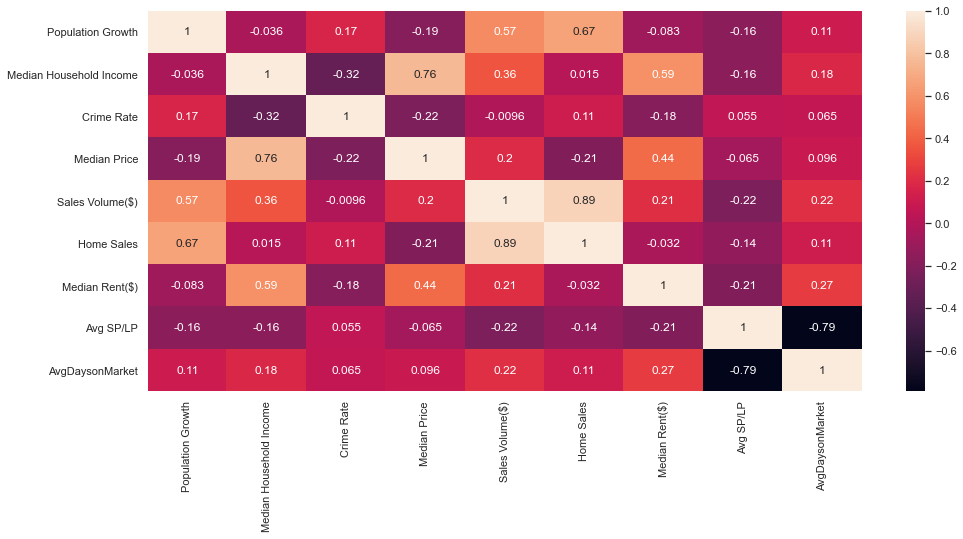

In [59]:
to_heat=Toronto[['Population Growth','Median Household Income','Crime Rate','Median Price','Sales Volume($)','Home Sales','Median Rent($)','Avg SP/LP','AvgDaysonMarket']]
plt.figure(figsize=(16,7))
ax=sns.heatmap(to_heat.corr(), annot = True)

We can see that **Median Household Income** has **high positive correlation** with the **Median House Price** and also
 **positively correlated** to the **Median Rent**, indicating that Neighbourhoods with high income have greater house prices , as well a greater rents.
 
The **Population Growth** has **high positive correlation** with **Home sales & Sales Volume**, indicating that areas with growing population are experiencing greater home sales, and that people are preferring to buy homes rather than rent in such areas.
 
The **Crime Rate** is **negatively correlated** to the **Median house price** as well as **Median Household Income**,
indicating that the higher the crime rate, the lower the house prices of that neighbourhood, and also that High income neighbourhoods, usually have slightly lower crime rates.

The **Average Sale Price to List Price** has **strong negative correlation** to **Average Days on Market**, indicating that the properties which are sold for more than the list price, have a very small number of days on the market, meaning they have a very high demand.


### Bar Charts

Let's visualize **features with multiple columns** by way of stacked bar charts.

### Age in Toronto Neighbourhoods

**Age** is an important factor when analyzing real estate, as neighbourhoods with more children and seniors naturally have more families, and such neighbourhoods are mostly residential and family-friendly. They are considered good investments in the long run.

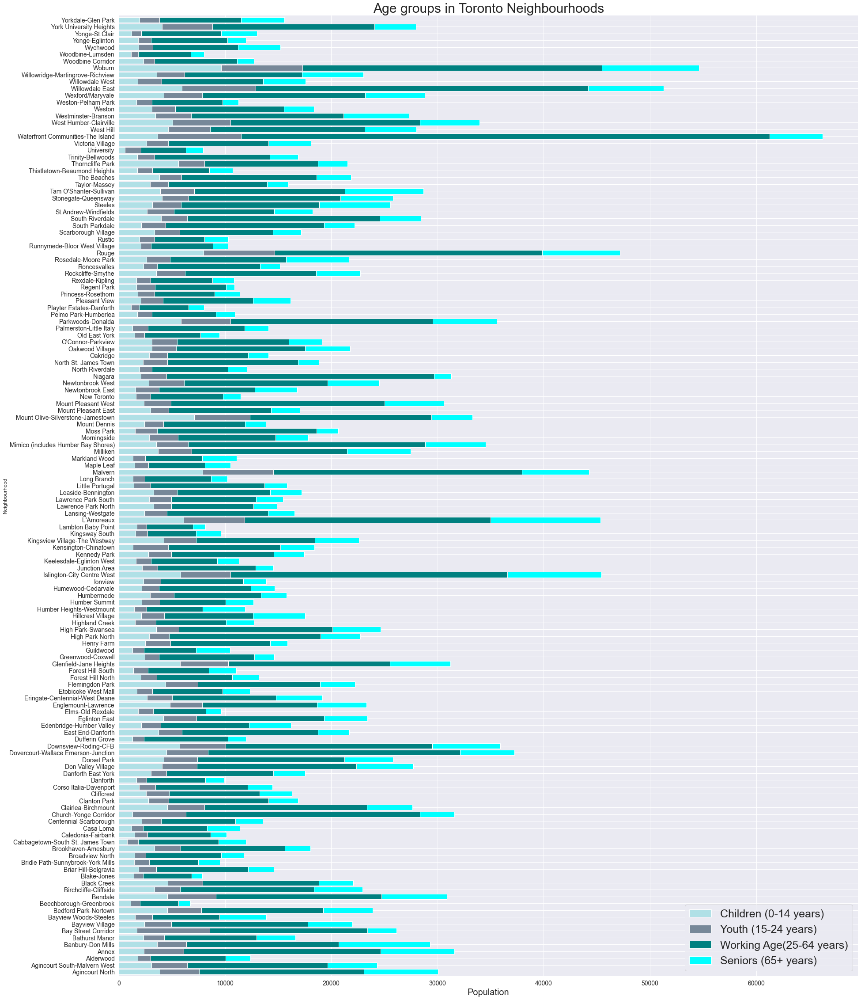

In [60]:
age=Toronto[['Children (0-14 years)',
 'Youth (15-24 years)',
 'Working Age(25-64 years)',
 'Seniors (65+ years)']]

ax= age.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=[ 'powderblue', 'lightslategray','teal','cyan'],
               fontsize=14)
ax.set_title('Age groups in Toronto Neighbourhoods',fontsize=30)
ax.set_xlabel('Population',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* Most of the neighbourhoods have the **highest number** of people in the **Working age (25-64 years)** category.
* **Woburn** has the **highest** number of **Children(0-14 years)**, and **University** has the lowest.
* **L'Amoreaux** and **Woburn** have the **highest** number of **Seniors(65+ years)**, and  **Blake Jones and Beechborough-Greenbrook** the **lowest**.
* **Woburn, Willowdale East, Waterfront Communities-The Island, and Bay Street Corridor** have the **highest** number of **Youth(15-24 years)**, while **Woodbine-Lumsden, Blake Jones and Beechborough Greenbrook** have the **lowest**.

### Educational Attainment 

Neighbourhoods with more educational attainment are considered more valuable, as education has a great impact on the outlook of a society. Highly educated areas naturally have higher income and employment, making them favourable for investment.

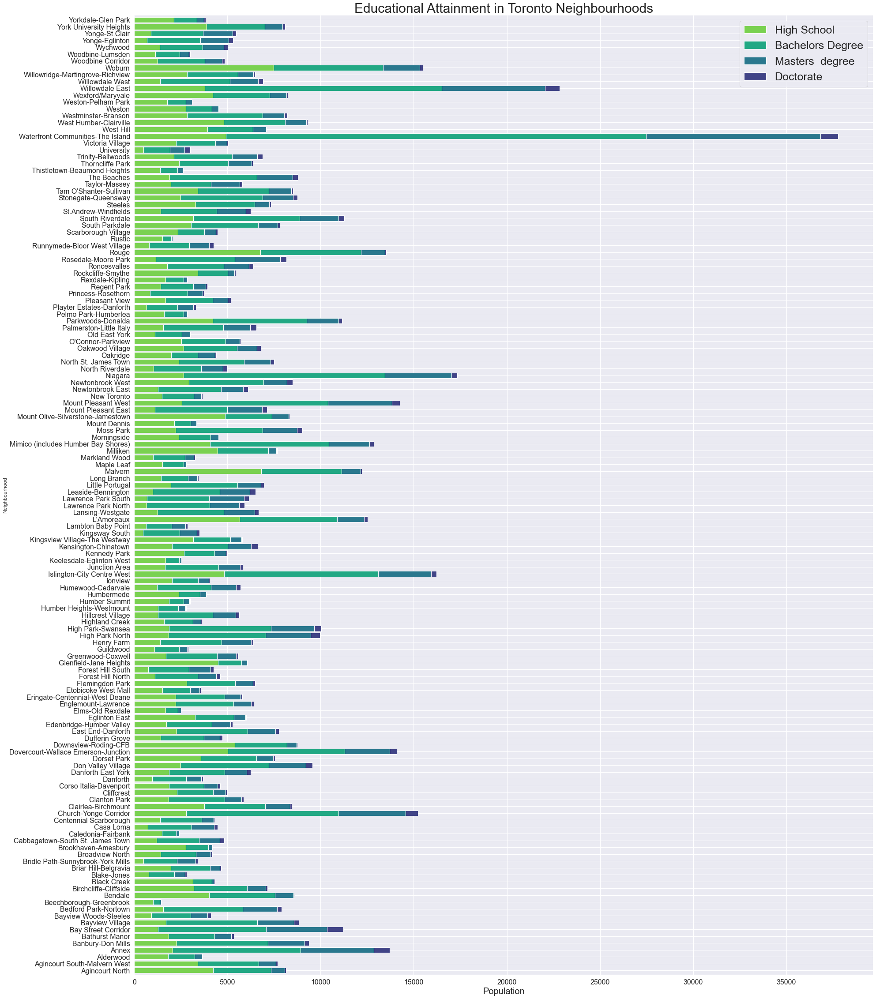

In [61]:
Education=Toronto[['High School','Bachelors Degree','Masters  degree','Doctorate']]
ax= Education.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=sns.color_palette("viridis_r",4),
               fontsize=16)
ax.set_title('Educational Attainment in Toronto Neighbourhoods',fontsize=30)
ax.set_xlabel('Population',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* The **least educated** neighbourhoods are **Beechborough-Greenbrook, Maple Leaf, Caledonia-Fairbank, Glenfield-Jane heights and Rustic**, with their highest education being **High School** mostly.
* The **most educated** neighbourhoods are **Waterfront Communities-The Island, Willowdale East, Annex, Bay street Corridor, Church-Yonge corridor and Niagara**,  with their highest education being a **Bachelors Degree and above**.

### Employment vs Unemployment Rate

High employment rate is always a plus point, whereas high unemployment rate is a big turn off for any real estate investor, because employment affects income, and low income areas don't have much investment potential.

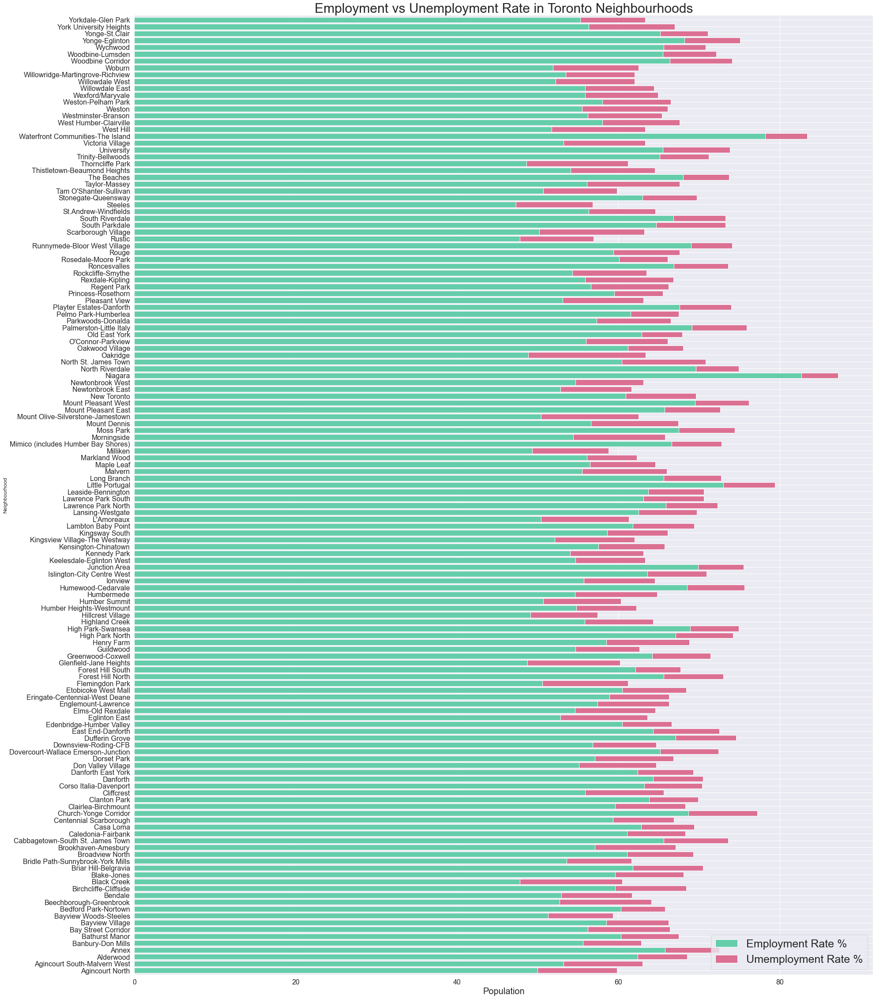

In [62]:
emp=Toronto[['Employment Rate %','Umemployment Rate %']]

ax= emp.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=['mediumaquamarine','palevioletred'],
               fontsize=16)
ax.set_title('Employment vs Unemployment Rate in Toronto Neighbourhoods',fontsize=30)
ax.set_xlabel('Population', fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* **Oakridge** has the **Highest unemployment Rate**, followed by **Scarborough Village and Thorncliffe Park**.
* **Niagara** has the **Highest Employment Rate**, followed by **Waterfront Communities-The Island**.

### Structure of the Houses

Houses can have the following structures:

* **A detached house** has open space on all sides, and has no dwellings either above it or below it.It is mostly occupied by families.
* **A semi-detached house** is a single family duplex dwelling house that shares one common wall with the next house.
* **Apartments** are part of buildings containing multiple rental units, sometimes organized as a community, and the buildings are often managed by a professional company. On the other hand, **condos** are also part of buildings with multiple units, but each unit is typically owned by a different individual. Both are attached dwellings.
* **Other attached dwelling** is a single dwelling that is attached to another building and that does not fall into any of the other categories.
* **Row houses** are houses having uniform, or nearly uniform, plans and fenestration and usually having a uniform architectural treatment, as in certain housing developments.

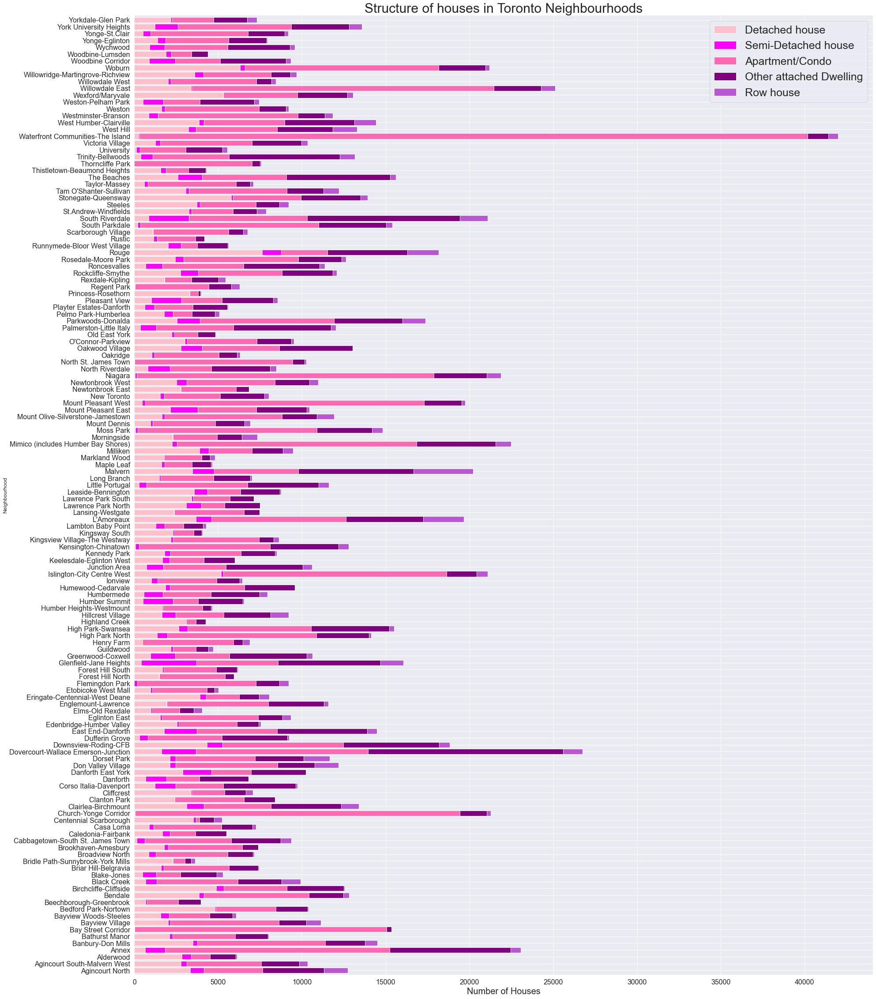

In [63]:
structure=Toronto[['Detached house',
 'Semi-Detached house',
 'Apartment/Condo',
 'Other attached Dwelling',
 'Row house']]

ax= structure.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=[ 'pink', 'magenta','hotpink','purple','mediumorchid'],
               fontsize=16)
ax.set_title('Structure of houses in Toronto Neighbourhoods',fontsize=30)
ax.set_xlabel('Number of Houses', fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* The majority of Neighbourhoods have **Apartment/Condominiums** as the **dominant house structure**, with **Waterfront Communities-The Islands** having the **highest** number of Apartment/Condominiums.
* **Malvern** has the most **Row Houses**, and **Glenfield-Jane Heights** has alot of **Semi-Detached Houses**.
* **Princess-Rosethorn,Centennial Scarborough and Highland Creek** have the most **Detached Houses**.
* **Dovercourt-Wallace Emerson-Junction and South Riverdale** have alot of **Other Attached Dwellings**.

### Number of Bedrooms

Neighbourhoods where more bedrooms are common ,are mostly occupied by families, whereas with fewer bedrooms, by singles or couples.

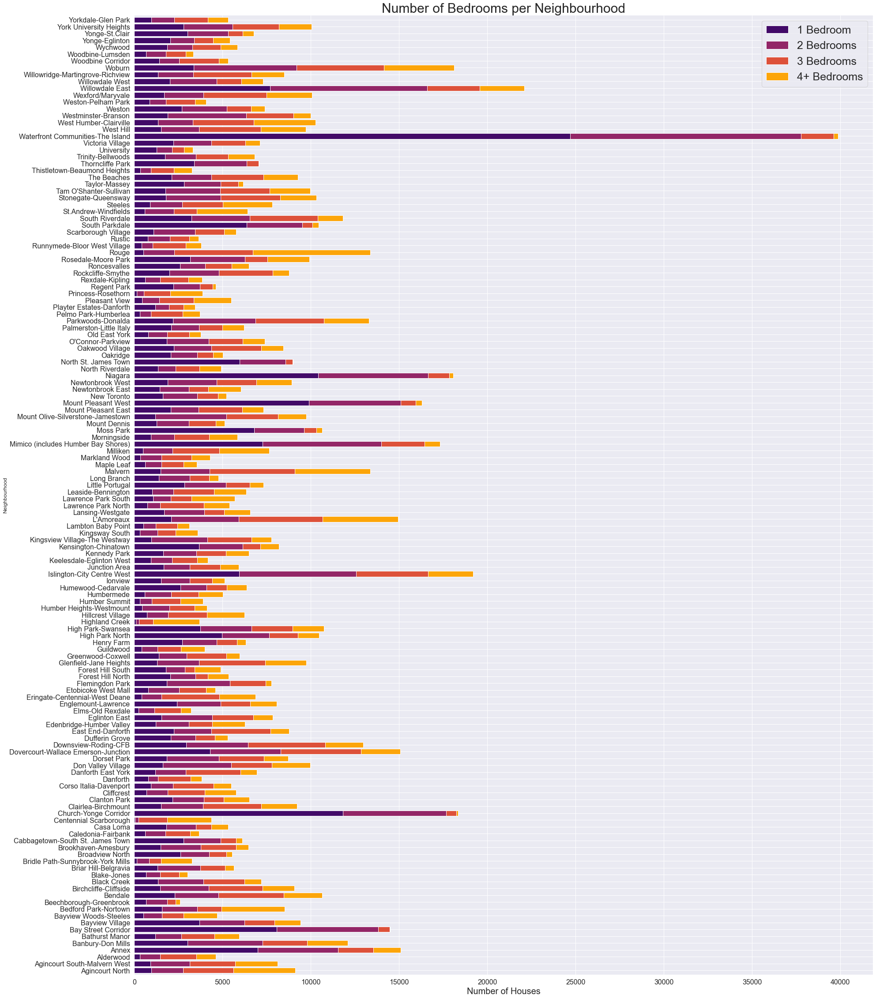

In [64]:
rooms=Toronto[['1 Bedroom',
 '2 Bedrooms',
 '3 Bedrooms',
 '4+ Bedrooms']]
ax= rooms.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=sns.color_palette("inferno", 4),
               fontsize=16)
ax.set_title('Number of Bedrooms per Neighbourhood',fontsize=30)
ax.set_xlabel('Number of Houses',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* A majority of neighbourhoods have an equal distribution of 1,2,3,4+ rooms.
* **Waterfront Communities-The Island, Church-Yonge Corridor, Niagara, and Bay Street Corridor** have a mojority of houses with **1 bedroom**. **Bridle Path-Sunnybrook-York Mills, Centennial Scarborough, Highland Creek and Princess Rosethorn** have **extremely few to no houses** with **1 Bedroom**.
* Neighbourhoods with a majority of **1 Bedroom** houses , also have a majority of **2 Bedroom** Houses most of the time.
* **Woburn** has the highest numer of houses with **3 Bedrooms**, followed by **Malvern, L'Amoreaux, Dovercourt-Wallace Emerson-Junction, Rouge**.
* **Rouge, Agincourt North, Centennial Scarborough, Highland Creek, Princess-Rosethorn, Bedford Park-Nortown** have the highest number of **4+ Bedroom** homes. 


### Year of Construction

More Newer constructions indicate the high development and demand for a neighbourhood, whereas more old constructions may mean more vintage expensive houses or not much scope for newer constrcutions, depending on the price and other factors.

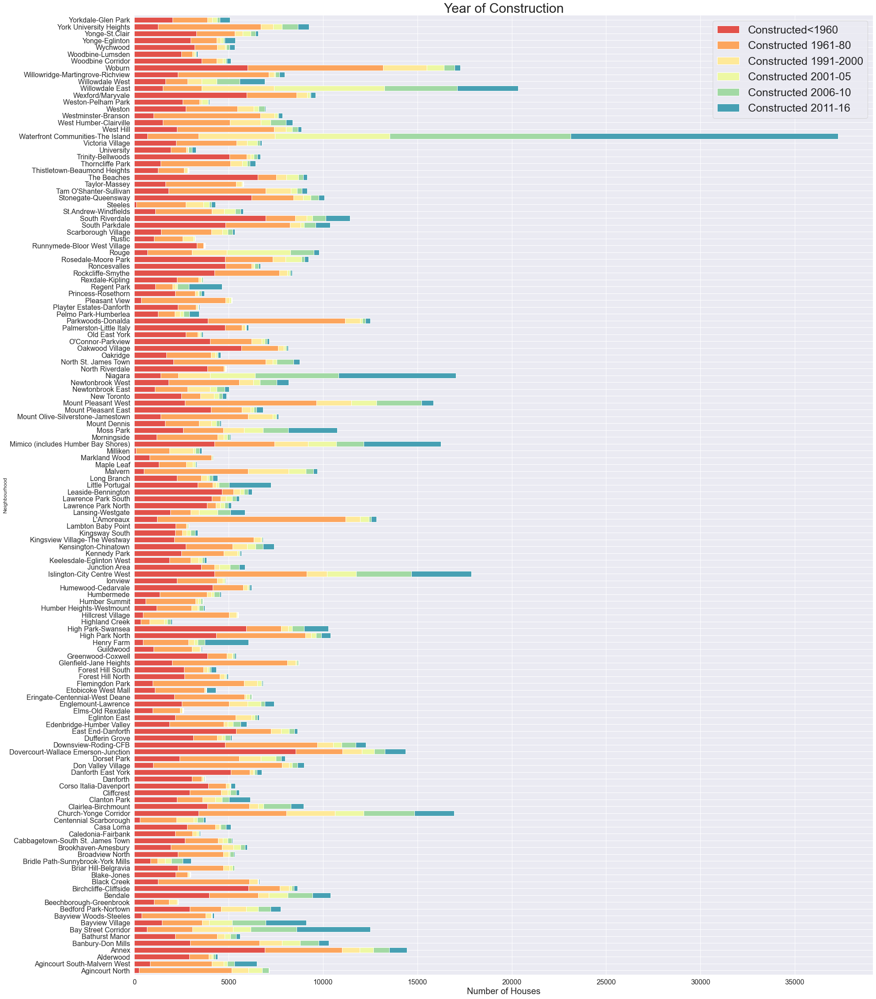

In [65]:
yearofcons=Toronto[['Constructed<1960','Constructed 1961-80','Constructed 1991-2000','Constructed 2001-05','Constructed 2006-10','Constructed 2011-16']]
ax= yearofcons.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=sns.color_palette("Spectral", 6),
               fontsize=16)
ax.set_title('Year of Construction',fontsize=30)
ax.set_xlabel('Number of Houses',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* The oldest houses **constructed < 1960** belong to the neighbourhoods of **Dovercourt-Wallace Emerson-Junction and South Riverdale**. **Miliken, Steeles and Centennial Scarborough** have the **least** number of old houses.
* **Woburn, L'Amoreaux, Parkwoods-Donalda, Agincourt North, Steeles** have the most number of houses **constructed 1961-80**. Overall, alot of neighbourhoods have a good portion of houses constructed in this duration.
* **Willowdale East and Waterfront Communities-The Island** have alot of houses **constructed 1991-2000**.
* **Willowdale East and Waterfront Communities-The Island and Rouge** have the most houses **constructed 2001-05**.
* **Willowdale East and Waterfront Communities-The Island and Niagara** have the most houses **constructed 2006-10**.
* **Waterfront Communities-The Island, Niagara and Bay Street Corridor** have the most houses **constructed 2011-16**.

### Owned vs Rented Houses

Areas with more owned homes, have greater potential for holding investments, to increase capital appreciation over time. Areas with more rented homes, offer immediate returns, and not much capital appreciation. However, this is subject to the markets conditions.

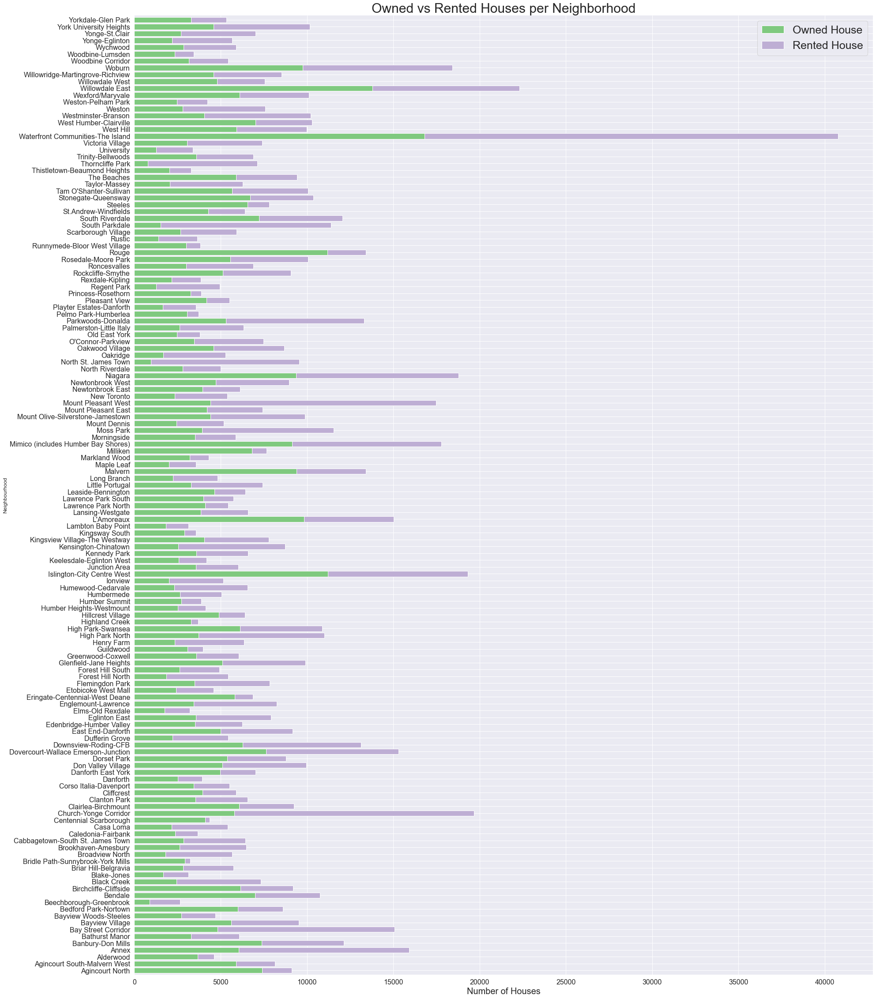

In [66]:
ovsr=Toronto[['Owned House', 'Rented House']]
ax= ovsr.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=sns.color_palette("Accent", 2),
               fontsize=16)
ax.set_title('Owned vs Rented Houses per Neighborhood',fontsize=30)
ax.set_xlabel('Number of Houses',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

* The neighbourhoods where most of the inhabitants live in their **owned houses** are **Agincourt North, Agincourt south-Malvern West, Alderwood, Woodbine-Lumsden, Runnymede-Bloor West Village, Princess-Rosethorn, Pelmo Park-Humberlea, Kingsway south, Highland Creek, centennial Scarborough,and Bridle Path-Sunnybrook-York Mills**. They also have the **least** number of **rented** houses.
* The neighbourhoods where most of the inhabitants live in **rented houses** are **Beechborough-Greenbrook, North St.James Town, Thorncliffe Park, Church-Yonge Corridor, Mount Pleasant West and Waterfront communities-The Island**.

### Amenities 

Good Proximity to amenities adds to the overall appeal of the property to buyers and tenants in the long run.

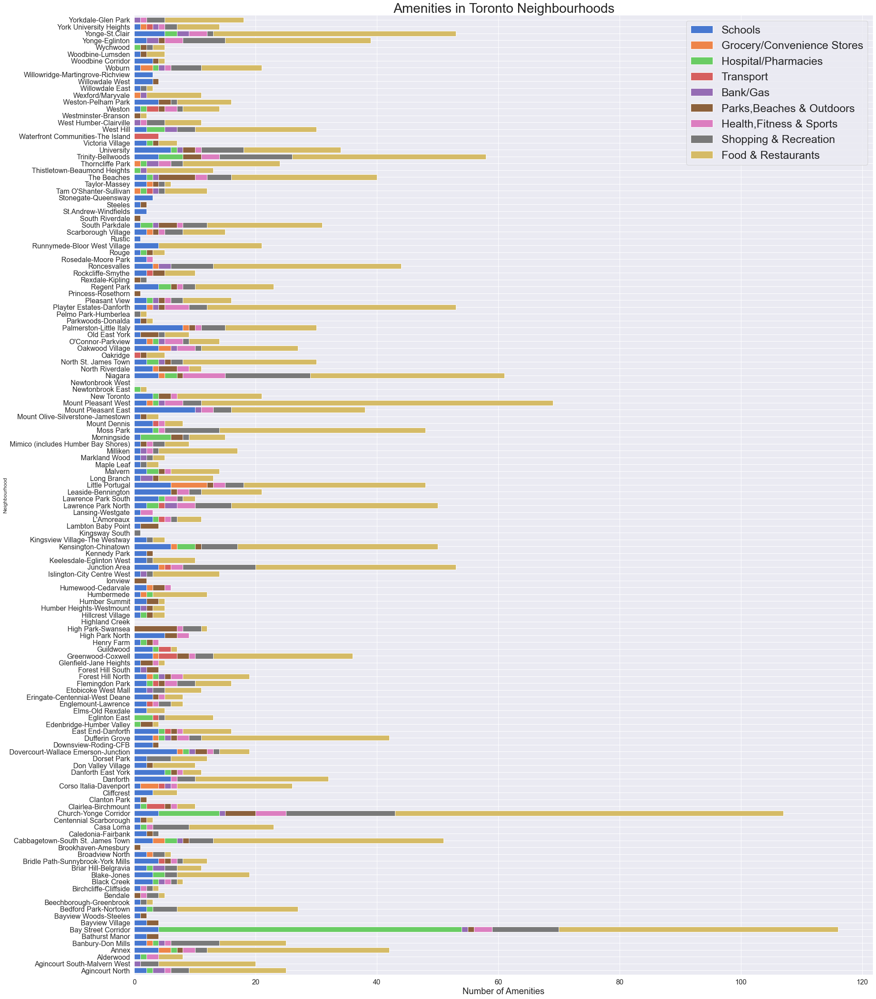

In [67]:
ams=Toronto[['Schools',
 'Grocery/Convenience Stores',
 'Hospital/Pharmacies',
 'Transport',
 'Bank/Gas',
 'Parks,Beaches & Outdoors',
 'Health,Fitness & Sports',
 'Shopping & Recreation',
 'Food & Restaurants']]
ax= ams.plot(kind='barh',stacked= True,
               figsize=(30,40),
               width=0.8,
               color=sns.color_palette("muted", 10),
               fontsize=16)
ax.set_title('Amenities in Toronto Neighbourhoods',fontsize=30)
ax.set_xlabel('Number of Amenities',fontsize=20)
ax.legend(fontsize=25)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

The **Foursquare API** returns mostly restaurants as venues, as observed above.
* The highest number of **Schools** are in **Mount Pleasant East**.
* The highest number of **Groceries** are in **Little Portugal and Corso Italia-Davenport**.
* The highest number of **Hospitals** are in **Bay Street corridor and Church-Yonge Corridor**.
* The highest number of **Transport** amenities are in **Waterfront communities-The Island and Clairlea-Birchmount**.
* **Banks/Gas** facilities are fairly well-distributed across neighbourhoods.
* The highest number of **Parks, Beaches and Outdoors** are in **High Park-Swansea, The Beaches and Church-Yonge Corridor**.
* The highest number of **Health,Fitness and Sports** amenities are in **Niagara and Church-Yonge Corridor**.
* The highest number of **Shopping and Recreation** facilities are in **Niagara, Church-Yonge Corridor, Trinity- Bellwoods and Bay Street Corridor**.
* The highest number of **Food and Restaurants** are in **Church-Yonge Corridor, Mount Pleasant West and Bay Street Corridor**.

## Choropleth Maps with Folium

### Population Growth

Let's visualize the population growth per neighbourhood.

In [68]:
pop_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

threshold_scale = np.linspace(-5,55,6)
threshold_scale = threshold_scale.tolist() # change the numpy array to a list
threshold_scale[-1] = threshold_scale[-1] + 1 

#choropleth map
pop_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Population Growth'],
    key_on='feature.properties.Neighbourhood',
    threshold_scale=threshold_scale,
    fill_color="RdPu",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Population Growth in Toronto')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(pop_map)  
    
pop_map

 The neighbourhoods with the **highest population growth** are **Waterfront communities-The Island** and **Niagara**.Followed by them are **Bay Street Corridor** and **Henry Farm**. 
 The neighbourhood with **highest population decline** is **Weston-Pellam Park**.

### Crime Rate ( per 1000 people)

Let's visualize the Crime Rate per neighbourhood.

In [69]:
crime_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

crime_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Crime Rate'],
    key_on='feature.properties.Neighbourhood',
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Crime Rate in Toronto')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(crime_map)  
    
crime_map

 The neighbourhoods with the **highest crime rate** are **Bay Street Corridor, Moss Park and Lambton Baby Point**.
Even the **surrounding areas** have a **high crime rate** i.e. **Church-Yonge Corridor, Kensington-Chinatown and University**.

### Median Income

In [70]:
income_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

#choropleth map

income_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Median Household Income'],
    key_on='feature.properties.Neighbourhood',
    fill_color="Oranges",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Median Income in Toronto')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(income_map)  
    
income_map

**Bridle Path-Sunnybrook-York Mills and the surrounding areas** have the **Highest Median Income**. Apart from them, the neighbourhoods of **Kingsway South and Princess-Rosethorn** also have high median income.

### House Prices

Let's visualize the House Prices per neighbourhood.

In [71]:
price_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

#choropleth map

price_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Median Price'],
    key_on='feature.properties.Neighbourhood',
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='House Prices in Toronto')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(price_map)  
    
price_map

 As you can see, the most expensive houses are at the **heart of the city**. The neighbourhoods with the **highest house  prices** are **Bridle Path-Sunnybrook-York Mills, Lawrence Park South and their surrounding areas**.
Away from the centre, the neighbourhoods of **Princess-Rosethorn and Kingsway South** have expensive homes.

### Rent 
Let's visualize the Rents for houses per neighbourhood.

In [72]:
rent_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

#choropleth map

rent_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Median Rent($)'],
    key_on='feature.properties.Neighbourhood',
    fill_color="Purples",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Median Rent in Toronto')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(rent_map)  
    
rent_map

 Again, the **highest rents** are at the **centre of the city**. The neighbourhood with the **highest rents** is **Bridle Path-Sunnybrook-York Mills**. Apart from that, the neighbourhoods of **Princess-Rosethorn, Cabbagetown-south St.James Town** and **Guildwood** also have high rents.

### Average Days on Market

Lower Average Days on Market, means that the property is sold very quickly, and is of high demand. Higher average Days on Market, means that the property is not sold quickly, and has lesser demand.
Let's visualize the Average Days on Market properties are listed, per neighbourhood.

In [73]:
dom_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

#choropleth map

dom_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','AvgDaysonMarket'],
    key_on='feature.properties.Neighbourhood',
    fill_color="Reds",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average Days on Market')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(dom_map)  
    
dom_map

The properties which are listed for the **highest number of days on the market** belong to the neighbourhood of **Bridle Path-Sunnybrook-York Mills**. Other neighbourhoods with high average days on market are **St.Andrew-Windfields, Bayview Village, Kingsview Village-The Westway, Kensington-Chinatown, Edenbridge-Humber Valley and Annex**.

### Average Sales Price to List Price 

A SP/LP above 100 means that the property is sold over the list price.
A SP/LP of 100 means that the property is sold at the list price.
A SP/LP below 100 means that the property is sold below the list price.
Let's visualize the Average Sales Price to List Price, per neighbourhood.

In [74]:
splp_map=folium.Map(location=[latitude,longitude],zoom_start=12)
path= 'Neighbourhoodboundaries.json' 

#choropleth map

splp_map.choropleth(
    geo_data=path,
    data=data,
    columns=['Neighbourhood','Avg SP/LP'],
    key_on='feature.properties.Neighbourhood',
    fill_color="PuRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average Sales Price to List Price')

#adding markers to the neighbourhoods

for lat, lng, neighborhood in zip(coordinates['Latitude'],coordinates['Longitude'],coordinates['Neighbourhoods']):
    label = '{}'.format(neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='dimgray',
        fill=True,
        fill_color='silver',
        fill_opacity=0.7,
        parse_html=False).add_to(splp_map)  
    
splp_map

The neighbourhoods with the **Highest Sales Price to List Price** are **Blake Jones, North Riverdale, Player Estates-Danforth and the surrounding neighbourhoods**. Apart from them, even **Runnymede-Bloor West Village** has a high SP/LP.
**Bridle Path-Sunnybrook-York Mills** has the **lowest SP/LP**.

## C.2. K-Means Clustering

Now that we have a good idea about the key features of the neighbourhoods of Toronto, let's apply the **k-means algorithm**, which is an unsupervised machine learning algorithm, to cluster the neighbourhoods, in order to **reveal their investment potential**.

**K-Means** will split the neighbourhoods in such a way that, the neighbourhoods withing a cluster will be very similar, and across different clusters will be dissimilar. 

In [75]:
import matplotlib.cm as cm  
import matplotlib.colors as colors
from sklearn.cluster import KMeans

Let's check if all data types are numeric

In [76]:
Toronto.dtypes

Population,2016                 int64
Population Growth             float64
Children (0-14 years)           int64
Youth (15-24 years)             int64
Working Age(25-64 years)        int64
Seniors (65+ years)             int64
High School                     int64
Bachelors Degree                int64
Masters  degree                 int64
Doctorate                       int64
Median Household Income         int64
Employment Rate %             float64
Umemployment Rate %           float64
Total Crime                     int64
Crime Rate                    float64
Detached house                  int64
Semi-Detached house             int64
Apartment/Condo                 int64
Other attached Dwelling         int64
Row house                       int64
Owned House                     int64
Rented House                    int64
1 Bedroom                       int64
2 Bedrooms                      int64
3 Bedrooms                      int64
4+ Bedrooms                     int64
Constructed<

In [149]:
toronto=pd.read_csv('em.csv')
toronto.head()


,Neighbourhood,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
0,Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
1,Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
2,Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425,1,0,1,0,0,0,2,0,4
3,Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
4,Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11


In [150]:
toronto=toronto.set_index('Neighbourhood')
toronto.head()

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425,1,0,1,0,0,0,2,0,4
Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11


### Normalizing the Data

In [151]:
from sklearn.preprocessing import StandardScaler
tor_scaled=StandardScaler().fit_transform(toronto)
tor_scaled

array([[ 0.96039964, -0.89510548,  0.64648539, ...,  0.19027016,
         0.40612173,  0.527366  ],
       [ 0.42467593,  0.44630473,  0.14995568, ..., -0.69765727,
         0.40612173,  0.527366  ],
       [-0.74589439, -0.30894304, -0.70355617, ...,  1.0781976 ,
        -0.61526226, -0.43880071],
       ...,
       [-0.69848344,  0.38994296, -1.06053831, ...,  1.96612503,
        -0.27480093,  2.45969941],
       [ 0.80836453, -0.50057306,  0.77954237, ...,  0.19027016,
         0.0656604 , -0.19725904],
       [-0.47083087, -0.36530481, -0.57374448, ...,  0.19027016,
         0.40612173,  0.28582432]])

Let's run the algorithm and group our neighbourhoods into **3 clusters**.

In [189]:
kclusters = 3
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=None).fit(tor_scaled)
kmeans.labels_[0:10]

array([1, 1, 0, 1, 1, 0, 2, 1, 0, 0], dtype=int32)

Let's add the cluster labels to our dataframe

In [190]:
toronto=toronto.drop('Cluster Labels',axis=1)
toronto.insert(0, 'Cluster Labels', kmeans.labels_)
toronto.head()

,Cluster Labels,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Agincourt North,1,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
Agincourt South-Malvern West,1,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
Alderwood,0,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.01,20,2425,1,0,1,0,0,0,2,0,4
Annex,1,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
Banbury-Don Mills,1,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11


### Visualizing the Clustered Neighbourhoods with Folium

In [191]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]



GeoJson(text).add_to(map_clusters) #adding boundaries to the map using a GeoJson file


# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(coordinates['Latitude'], coordinates['Longitude'], coordinates['Neighbourhoods'], toronto['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

## Analyzing Clusters

Now, we can **profile** our neighbourhoods based on the clusters above, and **assign them appropriate labels** based on the **common characteristics** of the neighbourhoods.

### Cluster 1

In [192]:
cluster1=toronto.loc[toronto['Cluster Labels'] == 0, toronto.columns[1:] ]
cluster1

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Alderwood,12054,1.3,1760,1235,7045,2335,1825,1415,390,25,83249,62.4,6.1,103,8.544881,2840,545,1145,1525,85,3675,950,325,1145,2055,1090,2905,1030,165,75,115,120,64,74920500,1170633,1060000,103,33,1.010,20,2425,1,0,1,0,0,0,2,0,4
Bathurst Manor,15873,2.8,2325,1940,8685,3650,1830,2485,880,155,69634,60.3,7.2,136,8.568009,2105,165,3765,1940,45,3285,2800,1200,1475,1860,1395,2165,2235,375,325,290,220,46,52230235,1135440,1110000,110,32,1.020,17,2497,2,0,0,0,0,2,0,0,0
Bayview Woods-Steeles,13154,-2.8,1515,1635,6315,4425,910,2105,915,180,74082,51.3,8.0,87,6.613958,1565,495,2445,1365,200,2720,1985,515,1050,1215,1920,400,3375,310,30,20,80,32,41147580,1285862,1321500,65,23,0.990,16,2100,1,0,0,0,0,1,0,0,0
Bedford Park-Nortown,23236,0.2,4555,3210,11485,4640,1545,4285,1845,220,116672,60.3,5.5,185,7.961783,4820,45,3570,1905,65,6005,2595,1570,1985,1395,3565,2935,1670,1335,615,655,555,56,131477036,2347804,2165000,151,74,0.990,19,3200,2,0,1,0,0,0,0,4,20
Beechborough-Greenbrook,6577,1.4,1120,855,3635,1110,1015,355,60,10,45211,52.7,11.4,98,14.900411,665,80,1885,1325,15,895,1755,665,1200,480,255,1045,800,420,40,10,25,14,15533555,1109540,950000,17,5,0.980,22,2100,1,0,0,0,0,0,0,1,1
Blake-Jones,7727,-0.5,1405,885,4545,1010,780,1380,550,90,64483,59.6,8.5,110,14.235797,495,815,1435,2170,370,1690,1435,675,780,1080,485,2200,625,70,45,25,10,26,31935400,1228285,1170000,39,6,1.160,7,2062,3,0,2,0,0,0,0,2,12
Briar Hill-Belgravia,14257,-0.3,1855,1655,8665,2410,1970,2095,525,60,60899,61.8,8.7,136,9.539174,1610,155,3880,1735,75,2835,2900,1325,2425,1400,480,2310,2415,310,180,85,10,28,22946238,819509,813050,57,25,1.030,18,1825,2,0,1,0,2,0,0,2,4
Bridle Path-Sunnybrook-York Mills,9266,6.3,1435,1425,4615,2030,485,1810,990,120,215792,53.6,8.0,88,9.497086,2275,40,700,380,230,2940,295,150,700,665,1740,865,375,400,315,600,450,54,226629500,4196843,2875000,134,81,0.910,42,7800,4,0,0,1,0,1,1,1,4
Broadview North,11499,-0.6,1470,1040,7115,2120,1410,1900,790,80,52731,61.1,8.2,94,8.174624,850,440,4290,1495,80,1805,3855,2625,1610,985,325,2305,2410,275,85,205,50,25,25526000,1021040,950000,44,9,1.040,19,1900,2,1,0,0,0,0,0,2,1


### Cluster 2

In [193]:
cluster2=toronto.loc[toronto['Cluster Labels'] == 1, toronto.columns[1:]]
cluster2

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Agincourt North,29113,-3.9,3840,3705,15535,6970,4240,3090,735,85,64686,50.0,9.8,160,5.495827,3345,805,3500,3660,1440,7395,1720,965,1790,2860,3490,245,4905,895,720,350,45,68,50774888,746690,766400,102,30,1.06,13,1750,2,0,1,0,2,0,1,3,16
Agincourt South-Malvern West,23757,8.0,3075,3360,13230,4660,3410,3270,920,85,61992,53.2,9.8,255,10.733678,2790,330,4450,2265,515,5890,2250,915,2235,2560,2405,835,3275,640,170,370,1200,120,83300152,694168,560000,207,69,1.02,19,1900,0,0,0,0,1,0,0,3,16
Annex,30526,4.6,2360,3750,18520,6950,2060,6855,3930,870,71053,65.8,6.7,455,14.905327,645,1185,13415,7215,595,6060,9870,6995,4555,2000,1540,6920,4080,950,715,840,940,100,175689955,1756900,1288500,401,221,0.99,24,4200,4,2,1,0,0,1,2,2,30
Banbury-Don Mills,27695,2.9,3605,2730,14365,8615,2265,4895,1970,245,77547,55.6,7.2,180,6.499368,3485,285,7625,2370,740,7390,4735,3010,4245,2545,2280,2970,3675,1185,950,990,540,121,155776209,1287407,870000,256,98,0.98,21,3750,2,1,1,0,1,0,1,8,11
Bayview Village,21396,21.1,2415,2505,12850,4225,1700,4895,1985,260,67355,58.5,7.7,149,6.963918,2025,120,6495,1615,880,5605,3930,3685,2555,1700,1475,1475,2110,375,1230,1770,2150,142,119121974,838887,609500,366,182,0.98,24,1850,2,0,0,0,0,2,0,0,0
Bendale,29960,7.5,4550,4605,15585,6150,4010,3540,990,55,60292,52.9,8.8,435,14.519359,3870,290,6265,2060,325,7000,3765,2285,2470,3700,2180,3970,2595,570,995,1305,960,121,86304612,713261,747500,230,70,1.04,13,1850,0,0,0,0,0,1,1,2,1
Birchcliffe-Cliffside,22291,2.0,3345,2440,12595,4540,3195,2865,985,105,73216,59.6,8.8,318,14.265847,4900,425,3785,3390,40,6145,3055,1475,2750,3030,1805,6050,1655,505,135,125,170,101,109013025,1079337,981500,174,53,1.02,13,2525,1,0,0,0,0,0,1,1,1
Black Creek,21737,-1.5,4600,3290,10950,3240,3155,1015,120,40,51999,47.8,12.7,383,17.619727,680,660,4850,2590,1140,2440,4880,1335,2580,2330,945,1250,4840,445,35,10,60,29,18080900,623479,620000,47,16,0.99,22,1850,3,0,1,0,1,0,1,1,1
Clairlea-Birchmount,26984,8.9,4565,3495,15300,4290,3750,3285,1315,110,68524,59.6,8.7,439,16.268900,3135,1015,4005,4195,1045,6065,3180,1505,2375,3305,2030,3875,2230,460,285,1450,665,124,104360113,841614,850000,168,29,1.07,12,2700,1,0,1,3,0,1,1,0,3


### Cluster 3

In [194]:
cluster3=toronto.loc[toronto['Cluster Labels'] == 2, toronto.columns[1:] ]
cluster3

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
Neighbourhood,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Bay Street Corridor,25797,33.3,1695,6860,14825,2750,1265,5810,3275,870,48737,56.2,10.2,1045,40.508586,5,0,15040,290,15,4835,10245,8070,5750,655,25,665,2405,2165,940,2415,3925,150,121929639,812864,690000,656,387,0.98,23,1800,4,0,50,0,1,1,3,11,46
Church-Yonge Corridor,31340,10.6,1260,5060,22015,3260,2785,8180,3595,665,56366,68.7,8.5,868,27.696235,10,25,19380,1625,220,5800,13865,11825,5845,580,100,3400,4660,2585,1500,2690,2115,218,160737548,737328,644000,929,477,0.99,22,2500,4,0,10,0,1,5,5,18,64
Niagara,31180,46.6,2055,2415,25205,1605,2650,10800,3565,330,79441,82.7,4.5,380,12.187300,35,110,17730,3150,860,9380,9395,10410,6240,1180,230,1395,940,1690,2370,4425,6230,314,238859347,760699,690000,855,273,1.01,14,2250,4,1,2,0,0,1,7,14,32
Waterfront Communities-The Island,65913,52.0,3650,7840,49785,5000,4920,22565,9335,950,78479,78.2,5.2,1267,19.222308,255,40,39880,1250,560,16825,23930,24695,13060,1870,230,705,2695,4055,6070,9600,14160,713,556293150,796667,724250,2565,1186,1.00,19,2000,0,0,0,4,0,0,0,0,0
Willowdale East,50434,12.0,5920,6940,31310,7100,3780,12725,5535,800,61725,55.9,8.5,311,6.166475,3385,65,18000,2830,845,13800,8505,7680,8905,2990,2510,1510,2050,3845,5850,3860,3215,297,282429211,950940,665000,712,304,0.99,20,2050,1,0,0,0,0,0,0,1,1


### Let's analyze the main characteristics of each cluster

In [198]:
cluster1.describe()

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
count,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,9.500000e+01,9.500000e+01,9.500000e+01,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000,95.000000
mean,14149.200000,2.881053,2161.789474,1703.526316,8022.000000,2615.473684,1586.894737,2218.894737,900.105263,134.526316,73813.663158,59.728421,8.101053,160.473684,11.403290,1557.736842,430.105263,3512.473684,2045.421053,237.842105,2974.736842,2783.894737,1547.947368,1557.157895,1459.000000,1072.842105,2405.473684,1836.263158,366.736842,198.789474,208.736842,277.736842,47.136842,5.747914e+07,1.207010e+06,1.108751e+06,93.526316,33.105263,1.030579,15.115789,2335.273684,2.231579,0.305263,0.536842,0.157895,0.336842,0.800000,0.747368,1.621053,9.189474
std,3960.948322,6.696447,879.538054,585.165404,2393.952309,994.252118,620.441323,993.994247,523.932541,96.665341,28367.972509,5.779525,1.891442,100.027001,5.870853,1035.536855,471.379245,2119.039560,1312.083706,224.882537,1051.597409,1732.224185,1273.264671,712.919400,564.907543,657.592584,1258.916301,1133.245426,263.317388,210.689996,236.765627,474.068947,19.240146,3.817879e+07,5.753732e+05,4.871217e+05,54.700314,26.823090,0.041934,5.361135,922.751683,1.864863,0.799916,0.896928,0.490675,0.612121,0.858004,0.999664,2.471880,11.288570
min,6577.000000,-7.600000,565.000000,675.000000,3635.000000,780.000000,455.000000,355.000000,60.000000,0.000000,39757.000000,47.800000,5.000000,51.000000,3.040238,0.000000,0.000000,210.000000,135.000000,0.000000,780.000000,280.000000,35.000000,190.000000,400.000000,20.000000,300.000000,335.000000,25.000000,0.000000,10.000000,0.000000,5.000000,4.111000e+06,5.123920e+05,4.580000e+05,15.000000,5.000000,0.910000,6.000000,1312.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,10958.000000,-0.550000,1542.500000,1285.000000,6102.500000,1887.500000,1120.000000,1422.500000,472.500000,55.000000,57694.500000,55.400000,6.800000,101.500000,7.728798,712.500000,80.000000,1987.500000,1037.500000,55.000000,2330.000000,1585.000000,665.000000,1055.000000,1100.000000,575.000000,1375.000000,925.000000,192.500000,55.000000,47.500000,42.500000,33.500000,3.607282e+07,8.365120e+05,8.022750e+05,59.000000,16.500000,1.005000,12.000000,1837.500000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,14133.000000,1.300000,1960.000000,1630.000000,7915.000000,2420.000000,1520.000000,2160.000000,875.000000,110.000000,66542.000000,60.300000,7.900000,137.000000,10.059350,1565.000000,215.000000,3275.000000,1805.000000,185.000000,2855.000000,2455.000000,1270.000000,1475.000000,1390.000000,970.000000,2260.000000,1595.000000,305.000000,130.000000,135.000000,110.000000,44.000000,4.703824e+07,1.059939e+06,9.750000e+05,83.000000,24.000000,1.020000,14.000000,2100.000000,2.000000,0.000000,0.000000,0.000000,0.0

In [199]:
cluster2.describe()

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
count,40.000000,40.000000,40.000000,40.000000,40.000000,40.00000,40.000000,40.00000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.00000,4.000000e+01,4.000000e+01,4.000000e+01,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000
mean,29568.325000,3.437500,4455.125000,3734.500000,16527.750000,5613.00000,3772.750000,4069.87500,1389.750000,177.125000,66052.425000,57.055000,8.900000,344.200000,11.827391,2950.125000,752.500000,6592.875000,3731.000000,911.750000,6346.250000,4884.625000,2507.500000,3199.000000,3126.750000,2224.875000,3172.250000,4009.750000,911.125000,566.125000,618.125000,619.375000,107.80000,9.616181e+07,8.893386e+05,8.127019e+05,211.050000,70.350000,1.031500,15.325000,2147.875000,1.550000,0.250000,0.525000,0.225000,0.425000,0.875000,0.600000,1.375000,7.675000
std,7707.205042,6.378115,1577.076363,1329.500002,4392.965086,1673.65859,1369.970498,1681.18414,832.941921,159.397453,11499.290642,6.259022,1.737667,172.469871,5.335078,1657.050394,712.029422,3272.872942,2227.729441,677.111654,1953.583738,2428.872374,1956.087146,1283.610793,910.610918,1156.767982,2300.973582,1964.260137,519.398675,610.677941,653.384372,836.865479,59.32492,5.579937e+07,2.515227e+05,2.098514e+05,143.813795,63.225908,0.032625,3.791945,539.872833,1.449138,0.543021,0.784056,0.576795,0.594311,1.470871,0.708918,1.778612,10.747421
min,21381.000000,-3.900000,2360.000000,2075.000000,10950.000000,2960.00000,1700.000000,1015.00000,120.000000,10.000000,51964.000000,47.300000,5.700000,43.000000,0.977428,415.000000,15.000000,2585.000000,1165.000000,40.000000,2440.000000,860.000000,500.000000,1665.000000,860.000000,340.000000,95.000000,965.000000,295.000000,35.000000,10.000000,35.000000,29.00000,1.808090e+07,5.574590e+05,4.750000e+05,47.000000,13.000000,0.980000,8.000000,1200.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,23901.500000,-0.125000,3531.250000,2718.750000,13447.500000,4477.50000,2840.000000,2955.00000,880.000000,71.250000,57843.000000,52.575000,7.600000,209.750000,7.739174,1741.250000,285.000000,4671.250000,2140.000000,462.500000,5103.750000,3633.750000,1440.000000,2257.500000,2522.500000,1523.750000,1248.750000,2457.500000,546.250000,168.750000,158.750000,193.750000,75.00000,5.972714e+07,7.379068e+05,6.646250e+05,123.000000,33.750000,1.010000,13.000000,1850.000000,0.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,27519.500000,2.050000,4052.500000,3340.000000,15100.000000,5570.00000,3487.500000,3817.50000,1182.500000,112.500000,64906.000000,56.050000,9.050000,317.500000,11.071153,2777.500000,522.500000,5507.500000,3172.500000,695.000000,6062.500000,4302.500000,1862.500000,2785.000000,2990.000000,2105.000000,2355.000000,3607.500000,760.000000,367.500000,360.000000,290.000000,90.00000,8.129248e+07,8.271085e+05,7.815000e+05,165.500000,48.000000,1.030000,15.000000,2000.000000,1.0000

In [200]:
cluster3.describe()

,"Population,2016",Population Growth,Children (0-14 years),Youth (15-24 years),Working Age(25-64 years),Seniors (65+ years),High School,Bachelors Degree,Masters degree,Doctorate,Median Household Income,Employment Rate %,Umemployment Rate %,Total Crime,Crime Rate,Detached house,Semi-Detached house,Apartment/Condo,Other attached Dwelling,Row house,Owned House,Rented House,1 Bedroom,2 Bedrooms,3 Bedrooms,4+ Bedrooms,Constructed<1960,Constructed 1961-80,Constructed 1991-2000,Constructed 2001-05,Constructed 2006-10,Constructed 2011-16,Home Sales,Sales Volume($),Average Price,Median Price,New Listings,Active Listings,Avg SP/LP,AvgDaysonMarket,Median Rent($),Schools,Grocery/Convenience Stores,Hospital/Pharmacies,Transport,Bank/Gas,"Parks,Beaches & Outdoors","Health,Fitness & Sports",Shopping & Recreation,Food & Restaurants
count,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000e+00,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
mean,40932.800000,30.900000,2916.000000,5823.000000,28628.000000,3943.000000,3080.000000,12016.000000,5061.000000,723.000000,64949.600000,68.340000,7.380000,774.200000,21.156181,738.000000,48.000000,22006.000000,1829.000000,500.000000,10128.00000,13188.000000,12536.000000,7960.000000,1455.000000,619.000000,1535.000000,2550.000000,2868.000000,3346.000000,4598.000000,5929.000000,338.400000,2.720498e+08,811699.600000,682650.000000,1143.400000,525.400000,0.994000,19.600000,2120.000000,2.600000,0.200000,12.400000,0.800000,0.400000,1.400000,3.000000,8.800000,28.600000
std,16811.562649,19.149151,1906.388602,2155.688985,13236.155786,2147.084069,1363.978556,6451.590308,2552.876809,243.351597,13601.194536,12.305405,2.424252,416.812548,13.473677,1483.355992,41.922548,10114.755558,1171.795631,376.115009,5139.07409,6340.888739,7007.006672,3131.243762,1001.211766,1060.745021,1111.783477,1354.275637,1039.889417,2441.276306,2915.498671,4841.703471,219.445437,1.709752e+08,83287.784172,30182.569473,802.146059,377.694718,0.011402,3.507136,265.988722,1.949359,0.447214,21.419617,1.788854,0.547723,2.073644,3.082207,7.981228,28.049955
min,25797.000000,10.600000,1260.000000,2415.000000,14825.000000,1605.000000,1265.000000,5810.000000,3275.000000,330.000000,48737.000000,55.900000,4.500000,311.000000,6.166475,5.000000,0.000000,15040.000000,290.000000,15.000000,4835.00000,8505.000000,7680.000000,5750.000000,580.000000,25.000000,665.000000,940.000000,1690.000000,940.000000,2415.000000,2115.000000,150.000000,1.219296e+08,737328.000000,644000.000000,656.000000,273.000000,0.980000,14.000000,1800.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,31180.000000,12.000000,1695.000000,5060.000000,22015.000000,2750.000000,2650.000000,8180.000000,3565.000000,665.000000,56366.000000,56.200000,5.200000,380.000000,12.187300,10.000000,25.000000,17730.000000,1250.000000,220.000000,5800.00000,9395.000000,8070.000000,5845.000000,655.000000,100.000000,705.000000,2050.000000,2165.000000,1500.000000,2690.000000,3215.000000,218.000000,1.607375e+08,760699.000000,665000.000000,712.000000,304.000000,0.990000,19.000000,2000.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
50%,31340.000000,33.300000,2055.000000,6860.000000,25205.000000,3260.000000,2785.000000,10800.000000,3595.000000,800.000000,61725.000000,68.700000,8.500000,868.000000,19.222308,35.000000,40.000000,18000.000000,1625.000000,560.000000,9380.00000,10245.000000,10410.000000,6240.000000,1180.000000,230.000000,1395.000000,2405.000000,2585.000000,2370.000000,3860.000000,3925.000000,297.000000,2.388593e+08,796667.000000,690000.000000,855.000000,387.000000,0.990000,20.000000,2050.

## Analysis

After carefully observing the clusters made by the k-means algorithm, the three clusters can be described as:

### Cluster 1 : Less Populated, Vintage

* This cluster consists of 95 neighbourhoods, but has the **lowest average total population** of ~14,000, and a **low population growth** of ~2.9%. 
* It comprises **mostly of families and seniors**, similar to Cluster 2.
* The **educational attainment is the high**, with 46% of the people having their highest education as 'Bachelors Degree' and 21% as 'Masters and Above'.
* They have the **highest average income** of ~$74,000, and the good Employment rate of ~60%.
* The **crime rate is the lowest**, when compared to other clusters.
* The houses are **mostly Apartments/Condominiums and other attached dwellings**, making up 72% of the neighbourhood houses.
* All number of bedrooms, from **1 to 4**, are common.
* The number of **owned and rented houses** is almost equal.
* Most of the **houses are very old**, with ~45% being constructed pre 1960's and 34% pre 1980's. It has sharply decreasing new constructions.
* The **houses prices are very expensive**, and the highest compared to the other clusters. The houses are mostly sold over the list price.
* The **rents are the highest**, compared to the other clusters.
* They have **moderate amenities** compared to the other clusters.



### Cluster 2 : Mid-Populated, Archetypal

* This cluster consists of 40 neighbourhoods which have an average total population of ~30,000, and **very less population growth**. 
* It comprises mostly of **families with children and seniors**, which account for 33% of the total population. 
* The **educational attainment is less**, with 41% of the people having their highest education as 'High School' and 42% as 'Bachelors Degree'.
* They have an average income of $64,940, lower than the other clusters, and a **high unemployment rate**.
* The crime rate is moderate, when compared to other clusters.
* The houses are **mostly attached dwellings**, making up ~69% of the neighbourhood houses, but also has a good number of detached houses i.e. ~31%.
* Houses with **2-3 bedrooms** are more common, accounting for 58% of the total houses.
* There are also **more owner occupied** homes rather than rented ones.
* Most of the **houses are old**, with 32% constructed in the pre-1960 and 43% in the 1961-80 period. It has few new constructions, and the number of **new constructions has declined sharply** 1990 onwards.
* The houses prices are **mid-ranged to expensive**, depending on the structure & bedrooms. The houses are mostly sold over the list price, an get sold very quickly.
* The **rents are mostly mid ranged**, but can be high depending of the house.
* They have **fairly fewer amenities** compared to the other clusters.

### Cluster 3: Densely populated, Bustling Urban

* This cluster consists of only 5 neighbourhoods, but has the **highest average total population of ~40,000, and extremely high population growth of ~30%**. 
* It has the **highest working-aged population** i.e. 68%, and most of them seem to be **single or couples without children**.
* The **educational attainment is the highest**, with ~56% of the people having their highest education as 'Bachelors Degree' and ~27% as 'Masters and Above'.
* They have an average income of ~$65,000, and the **highest Employment rate** of ~68%.
* The **crime rate is the highest**, when compared to other clusters.
* The houses are **mostly Apartments/Condominiums**, making up ~84% of the neighbourhood houses.
* Houses with **1-2 bedrooms** are the most common, accounting for ~90% of the total houses.
* There are also **more rent occupied** homes rather than owned ones.
* Most of the **houses are new**, with ~63% being constructed post 2000. It has rapidly increasing new constructions.
* The **houses prices are low to mid-ranged**, and much more affordable compared to the other clusters. The houses are mostly sold a little less than or equal to the list price.
* The **rents are mostly mid ranged**, and don't vary much.
* They have the **highest amenities** compared to the other clusters.

## D. Results and Discussion

The Neighbourhood Analysis of the 140 neighbourhoods of Toronto have revealed the investment potential for these neighbourhoods, based on their characteristics. Let's look at it from the point of view of both individual investors and Real Estate companies.

**a.** For an investor looking to invest in an area with **high development & growth, close proximity to commercial/business outlets, new modern constructions, and at the same time  mid-ranged capital investment**, the neighbourhoods of **Cluster 3** are the most ideal. 
* An **Individual** investor can opt for **buying a Condominium**, for rental property investment, as they are the most popular house structure here, and fetch good rents. However, if an individual wants to opt for a **buy and hold strategy**, it may or may not profitable, as houses in these neighbourhoods usually sell a little below or equal to the list price. Moreover, houses don't sell as quickly as the other clusters.
* A **Real Estate Company** can find it profitable to invest in an **Apartment**, as most of the inhabitants in these neighbourhoods live in rented homes. Another key point is that smaller homes with 1-2 bedrooms are more in demand than bigger homes in such neighbourhoods.

A downside to investing in these areas is the extremely high crime rate, probably because of the presence of Commercial establishments, markets and businesses, as some crimes take place in bustling areas i.e.Robbery. This may explain why there are less families and more singles' living in these neighbourhoods. 


**b.** For an investor looking to invest in an **Archetypal, family-friendly neighbourhood, with great value**, the neighbourhoods of **Cluster 2** are favourable.
* An **individual** investor looking for a home to **live in with his family, or to earn rental income**, can invest in the  properties of these neighbourhoods. These neighbourhoods have a **good capital appreciation**, and are very profitable in the long run. They have a **low crime rate**, and have a pleasant ambience. Most of the homes are owner occupied, and increase in value overtime. 
* A **Real Estate Company** can invest in both Apartments or Detached houses. There is a high demand for homes in such neighbourhoods as they get sold very quickly, and mostly above the list price. Big homes with more than 2 bedrooms are  high in demand, due to family size.

A downside of these neighbourhoods is that the educational attainment is less, and unemployment is high. This may have a negative impact on timely payment of rents, in case of rental property investment.


**c.** For an investor looking to invest in a **swanky,peaceful & posh neighbourhood**, **Cluster 1** has many neighbourhoods of this kind! 
* An **individual** investor wanting ot live in a well-educated, high-class neighbourhood, or simply wanting high capital appreciation, can invest in suitable neighbourhoods in this cluster. Rental property investment is also a great option, with high return on investment. It has the safest neighbourhoods, with the **lowest crime rate**. There is an equal distribution of owned and rented houses, so both **buy and hold strategy and rental property investment** are great, depending on the requirements of the investor.
* A **Real Estate Company** can invest in Apartments, of any size, big or small, as rents are high for both, or in big houses like mansions in certain areas, which are sold for high prices. There is high demand for residential real estate and homes are sold mostly above the list price.

A downside of these neighbourhoods is that there is the presence of working class neighbourhoods, as the k-means algorithm has classified some neighbourhoods on the basis of Total population. So, before investing, one must carefully observe the neighbourhoods individually.

## E. Conclusion

The goal of this project was to identify the neighbourhoods of Toronto with high investment potential and return on investment.

With the help of Demographic, Location and Real Estate data, insightful visualizations, and then ultimately clustering the neighbourhoods, we could identify areas for potential investment, depending on the preferances of the investor.

Throughout the analysis, a neighbourhood which constantly stood out was **Waterfront Communities-The Island**. In my opinion, it has the highest investment potential, no matter who the investor is. It has the highest development, population growth, education, proximity to amenities.....and so on. Moreover, the prices are very reasonable.

Some other neighbourhoods with great investment potential are Niagara, Willowdale East and Runnymede-Bloor West Village. I think that these neighbourhoods would exceed the investors expectations in the short as well as long run.

However, the ultimate decision, to invest or not to invest, depends on the investor, as everyone has their own needs and preferances.

Hopefully, this analysis will be helpful to anyone who wants to answer the question,
                                    **"Is this area worth a closer look?"**

